#Baseline DCGAN
Based on the official [TensorFlow](https://www.tensorflow.org/tutorials/generative/dcgan#create_the_models) DCGAN tutorial

##Imports

In [1]:
import tensorflow as tf

In [2]:
# To generate GIFs
!pip install imageio
!pip install git+https://github.com/tensorflow/docs

  Cloning https://github.com/tensorflow/docs to /tmp/pip-req-build-_fcesrdi
  Running command git clone --filter=blob:none --quiet https://github.com/tensorflow/docs /tmp/pip-req-build-_fcesrdi
  Resolved https://github.com/tensorflow/docs to commit 0e030ebf893fff8819a108d5f4449ae1829e2a8d
  Preparing metadata (setup.py) ... done
  Created wheel for tensorflow-docs: filename=tensorflow_docs-2025.10.13.34193-py3-none-any.whl size=187038 sha256=e6883bbb4e06e104811b988738eb17dfc4d2b15d0534c9c6142941f50d52b2ca
  Stored in directory: /tmp/pip-ephem-wheel-cache-0ycs2xyz/wheels/3e/88/34/48d2789bc9d37b33ddce06bccc454fae0285e5396d0a5be9d9
Successfully built tensorflow-docs


In [3]:
import glob
import imageio
import matplotlib.pyplot as plt
import numpy as np
import os
import PIL
from tensorflow.keras import layers
import time

from IPython import display

##Load and Prepare the Dataset

In [4]:
(train_images, train_labels), (_, _) = tf.keras.datasets.mnist.load_data()

11490434/11490434 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step


In [5]:
train_images = train_images.reshape(train_images.shape[0], 28, 28, 1).astype('float32')
train_images = (train_images - 127.5) / 127.5 # Normalize [-1, 1]

BUFFER_SIZE = 60000
BATCH_SIZE = 256

In [6]:
#Batch and shuffle the data
train_dataset = tf.data.Dataset.from_tensor_slices(train_images).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

##Create the Models

###The Generator

In [7]:
def make_generator_model():
  model = tf.keras.Sequential()
  model.add(layers.Dense(7*7*256, use_bias=False, input_shape=(100,)))
  model.add(layers.BatchNormalization())
  model.add(layers.LeakyReLU())

  model.add(layers.Reshape((7, 7, 256)))
  assert model.output_shape == (None, 7, 7, 256) # Note: None is the batch size

  model.add(layers.Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same', use_bias=False))
  assert model.output_shape == (None, 7, 7, 128)
  model.add(layers.BatchNormalization())
  model.add(layers.LeakyReLU())

  model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
  assert model.output_shape == (None, 14, 14, 64)
  model.add(layers.BatchNormalization())
  model.add(layers.LeakyReLU())

  model.add(layers.Conv2DTranspose(1, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
  assert model.output_shape == (None, 28, 28, 1)

  return model

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


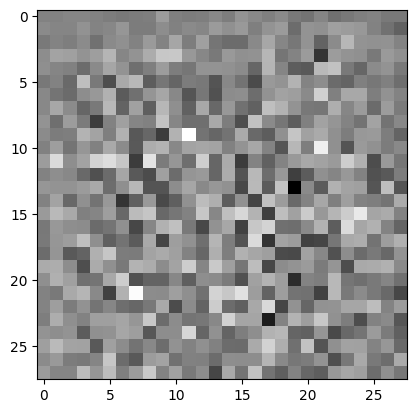

In [8]:
#use the untrained generator to create an image
generator = make_generator_model()

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

###The Discriminator

In [9]:
def make_discriminator_model():
  model = tf.keras.Sequential()
  model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same', input_shape=[28, 28, 1]))
  model.add(layers.LeakyReLU())
  model.add(layers.Dropout(0.3))

  model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
  model.add(layers.LeakyReLU())
  model.add(layers.Dropout(0.3))

  model.add(layers.Flatten())
  model.add(layers.Dense(1))

  return model

In [10]:
#use the untrained discriminator to classify the generated images as real (positive values) or fake (negative values)
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print(decision)

/usr/local/lib/python3.12/dist-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


tf.Tensor([[-0.00298403]], shape=(1, 1), dtype=float32)


##Define the loss and optimizers

In [11]:
#Returns a helper function to compute Cross Entropy Loss
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

###Discriminator loss
How well is the discriminator able to distinguish real images from fakes?

In [12]:
def discriminator_loss(real_output, fake_output):
  real_loss = cross_entropy(tf.ones_like(real_output), real_output)
  fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
  total_loss = real_loss + fake_loss #could add weights here to change the training model
  return total_loss

###Generator loss
How well is the generator able to trick the discriminator?

In [13]:
def generator_loss(fake_output):
  return cross_entropy(tf.ones_like(fake_output), fake_output)

###Optimizers

In [14]:
#discriminator and generator networks are separate, so optimizers can be the same or different (but they are always separate)
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

In [15]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

###Save Checkpoint

In [16]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

##Defining the Training Loop

In [17]:
#Define the training loop
EPOCHS = 50
noise_dim = 100
num_examples_to_generate = 16

#Reusing this seed overtime (so it's easier) to visualize progress in the animated GIF
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [18]:
@tf.function #to compile the function
def train_step(images):
  noise = tf.random.normal([BATCH_SIZE, noise_dim])
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_images = generator(noise, training=True)

    real_output = discriminator(images, training=True)
    fake_output = discriminator(generated_images, training=True)

    gen_loss = generator_loss(fake_output)
    disc_loss = discriminator_loss(real_output, fake_output)

  gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
  gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

  return gen_loss, disc_loss

In [19]:
def train(dataset, epochs):
  gen_loss_history = []
  disc_loss_history = []

  for epoch in range(epochs):
    start = time.time()

    epoch_gen_loss = 0.0
    epoch_disc_loss = 0.0
    batch_count = 0

    for image_batch in dataset:
      gen_loss_batch, disc_loss_batch = train_step(image_batch)

      epoch_gen_loss += float(gen_loss_batch.numpy())
      epoch_disc_loss += float(disc_loss_batch.numpy())
      batch_count += 1

    #average loss over batches
    epoch_gen_loss /= batch_count
    epoch_disc_loss /= batch_count

    gen_loss_history.append(epoch_gen_loss)
    disc_loss_history.append(epoch_disc_loss)

    #Produce images for the GIF
    display.clear_output(wait=True)
    generate_and_save_images(generator, epoch + 1, seed)

    #Save the model every 10 epochs
    if (epoch + 1) % 10 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  #Generate after the final epoch
  display.clear_output(wait=True)
  generate_and_save_images(generator, epochs, seed)

  return gen_loss_history, disc_loss_history


In [20]:
#Generate and save images
def generate_and_save_images(model, epoch, test_input):
  #training=False is so all layers run in inference mode (batchnorm)
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
    plt.subplot(4, 4, i+1)
    plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
    plt.axis('off')

  save_path = f"{run_dir}/image_at_epoch_{epoch:04d}.png"
  plt.savefig(save_path)
  plt.show()
  plt.close(fig)

##Training the Model

In [21]:
#folder
RUN_LABEL = "50epochs"
run_dir = f"runs/{RUN_LABEL}"
os.makedirs(run_dir, exist_ok=True)

print("Saving images + GIF for this run in:", run_dir)

Saving images + GIF for this run in: runs/50epochs


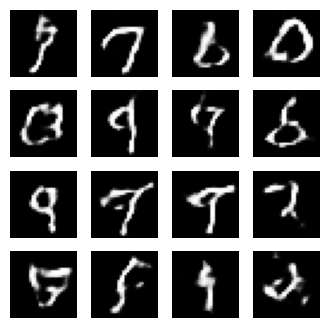

In [22]:
gen_loss_hist, disc_loss_hist = train(train_dataset, EPOCHS) #50 epochs

In [23]:
#Restore the latest checkpoint
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [24]:
#Use imageio to create an animated gif using the images saved during training
anim_file =  f"{run_dir}/dcgan.gif"

n=10

with imageio.get_writer(anim_file, mode='I', loop=n) as writer:
  filenames = glob.glob(f"{run_dir}/image_at_epoch_*.png")
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

/tmp/ipython-input-192076377.py:10: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
/tmp/ipython-input-192076377.py:12: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



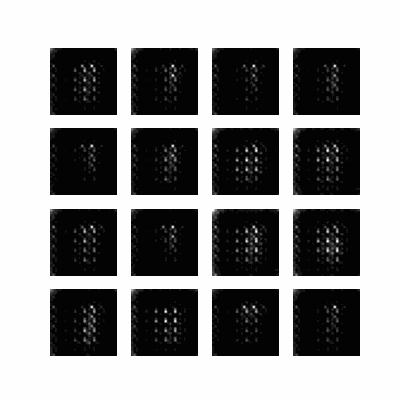

In [25]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

/tmp/ipython-input-873666131.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_start = imageio.imread(first_epoch_path)
/tmp/ipython-input-873666131.py:6: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_end = imageio.imread(final_epoch_path)


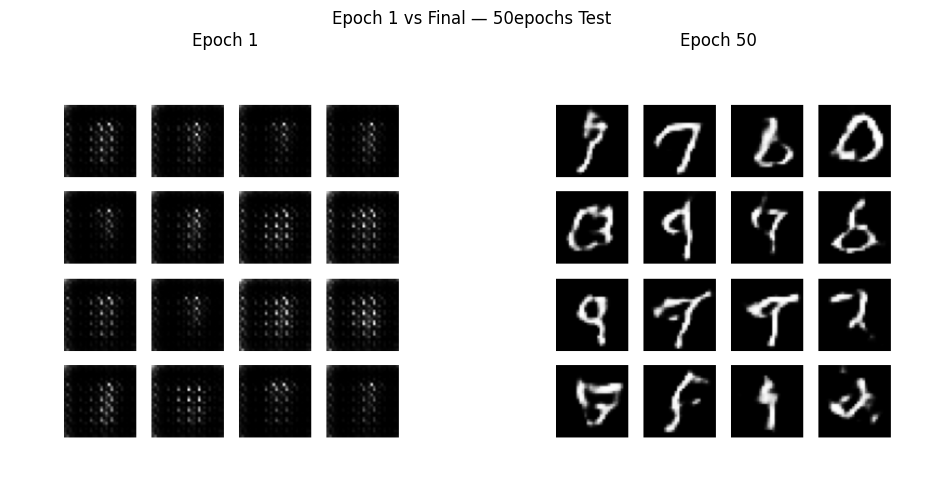

In [26]:
#Show First and Final Epoch Images
first_epoch_path = os.path.join(run_dir, "image_at_epoch_0001.png")
final_epoch_path = os.path.join(run_dir, f"image_at_epoch_{EPOCHS:04d}.png")

img_start = imageio.imread(first_epoch_path)
img_end = imageio.imread(final_epoch_path)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(img_start)
plt.title("Epoch 1")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(img_end)
plt.title(f"Epoch {EPOCHS}")
plt.axis("off")

plt.suptitle(f"Epoch 1 vs Final — {RUN_LABEL} Test")
plt.tight_layout()
plt.show()

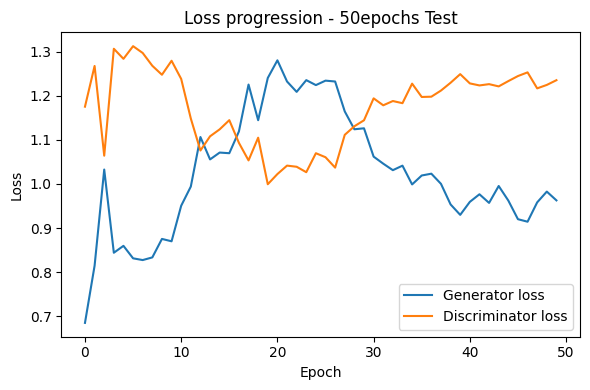

In [27]:
#Plot Loss Curves
plt.figure(figsize=(6, 4))
plt.plot(gen_loss_hist, label="Generator loss")
plt.plot(disc_loss_hist, label="Discriminator loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title(f"Loss progression - {RUN_LABEL} Test")
plt.legend()
plt.tight_layout()

loss_plot_path = f"{run_dir}/loss_curve.png"
plt.savefig(loss_plot_path)
plt.show()
plt.close()

##Changing Number of Iterations

###10 Epochs

####Redefining Generator, Discriminator, Optimizers and Checkpoint

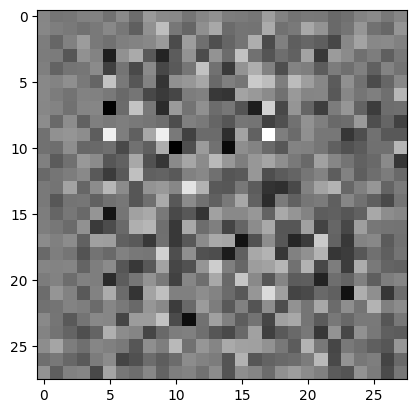

In [28]:
generator = make_generator_model()

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

In [29]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[-0.00163762]], shape=(1, 1), dtype=float32)


In [30]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

In [31]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

####Training the New Model

In [32]:
#Define the training loop
EPOCHS = 10
noise_dim = 100
num_examples_to_generate = 16

#Reusing this seed overtime (so it's easier) to visualize progress in the animated GIF
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [33]:
@tf.function #to compile the function
def train_step(images):
  noise = tf.random.normal([BATCH_SIZE, noise_dim])
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_images = generator(noise, training=True)

    real_output = discriminator(images, training=True)
    fake_output = discriminator(generated_images, training=True)

    gen_loss = generator_loss(fake_output)
    disc_loss = discriminator_loss(real_output, fake_output)

  gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
  gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

  return gen_loss, disc_loss

In [34]:
def train(dataset, epochs):
  gen_loss_history = []
  disc_loss_history = []

  for epoch in range(epochs):
    start = time.time()

    epoch_gen_loss = 0.0
    epoch_disc_loss = 0.0
    batch_count = 0

    for image_batch in dataset:
      gen_loss_batch, disc_loss_batch = train_step(image_batch)

      epoch_gen_loss += float(gen_loss_batch.numpy())
      epoch_disc_loss += float(disc_loss_batch.numpy())
      batch_count += 1

    #average loss over batches
    epoch_gen_loss /= batch_count
    epoch_disc_loss /= batch_count

    gen_loss_history.append(epoch_gen_loss)
    disc_loss_history.append(epoch_disc_loss)

    #Produce images for the GIF
    display.clear_output(wait=True)
    generate_and_save_images(generator, epoch + 1, seed)

    #Save the model every 10 epochs
    if (epoch + 1) % 10 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  #Generate after the final epoch
  display.clear_output(wait=True)
  generate_and_save_images(generator, epochs, seed)

  return gen_loss_history, disc_loss_history


In [35]:
#Generate and save images
def generate_and_save_images(model, epoch, test_input):
  #training=False is so all layers run in inference mode (batchnorm)
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
    plt.subplot(4, 4, i+1)
    plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
    plt.axis('off')

  save_path = f"{run_dir}/image_at_epoch_{epoch:04d}.png"
  plt.savefig(save_path)
  plt.show()
  plt.close(fig)

In [36]:
#folder
RUN_LABEL = "10epochs"
run_dir = f"runs/{RUN_LABEL}"
os.makedirs(run_dir, exist_ok=True)

print("Saving images + GIF for this run in:", run_dir)

Saving images + GIF for this run in: runs/10epochs


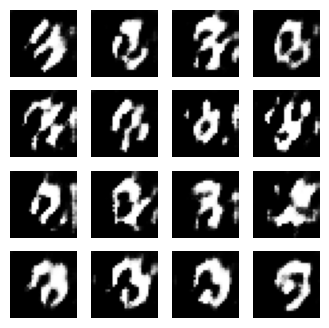

In [37]:
gen_loss_hist, disc_loss_hist = train(train_dataset, EPOCHS) #10 epochs

In [38]:
#Restore the latest checkpoint
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [39]:
#Use imageio to create an animated gif using the images saved during training
anim_file =  f"{run_dir}/dcgan.gif"

n=10

with imageio.get_writer(anim_file, mode='I', loop=n) as writer:
  filenames = glob.glob(f"{run_dir}/image_at_epoch_*.png")
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

/tmp/ipython-input-192076377.py:10: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
/tmp/ipython-input-192076377.py:12: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



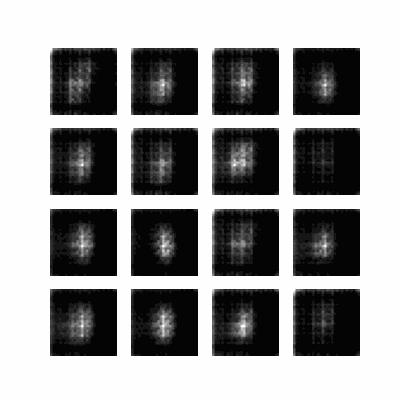

In [40]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

/tmp/ipython-input-873666131.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_start = imageio.imread(first_epoch_path)
/tmp/ipython-input-873666131.py:6: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_end = imageio.imread(final_epoch_path)


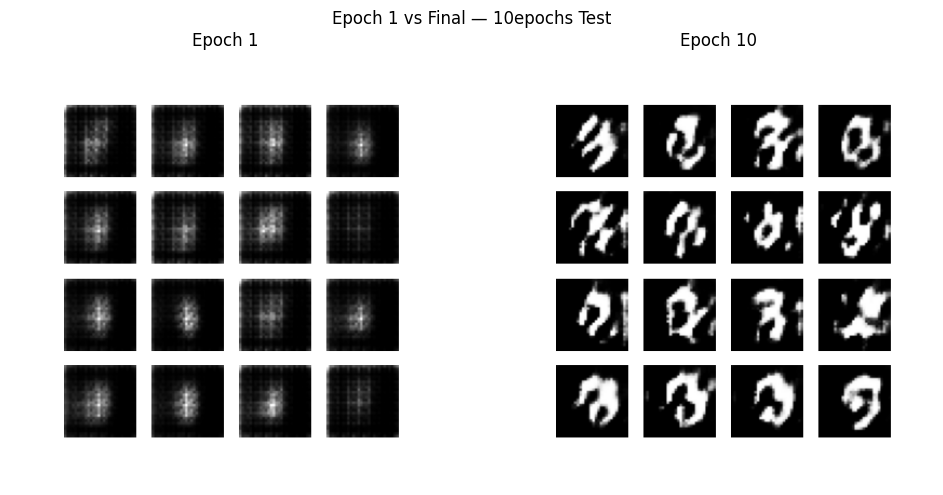

In [41]:
#Show First and Final Epoch Images
first_epoch_path = os.path.join(run_dir, "image_at_epoch_0001.png")
final_epoch_path = os.path.join(run_dir, f"image_at_epoch_{EPOCHS:04d}.png")

img_start = imageio.imread(first_epoch_path)
img_end = imageio.imread(final_epoch_path)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(img_start)
plt.title("Epoch 1")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(img_end)
plt.title(f"Epoch {EPOCHS}")
plt.axis("off")

plt.suptitle(f"Epoch 1 vs Final — {RUN_LABEL} Test")
plt.tight_layout()
plt.show()

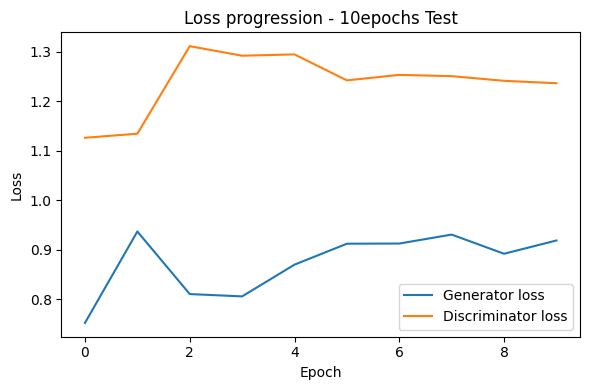

In [42]:
#Plot Loss Curves
plt.figure(figsize=(6, 4))
plt.plot(gen_loss_hist, label="Generator loss")
plt.plot(disc_loss_hist, label="Discriminator loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title(f"Loss progression - {RUN_LABEL} Test")
plt.legend()
plt.tight_layout()

loss_plot_path = f"{run_dir}/loss_curve.png"
plt.savefig(loss_plot_path)
plt.show()
plt.close()

###100 Epochs

####Redefining Generator, Discriminator, Optimizers and Checkpoint

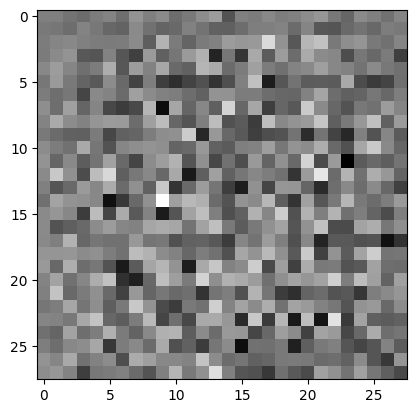

In [43]:
generator = make_generator_model()

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

In [44]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[0.0001085]], shape=(1, 1), dtype=float32)


In [45]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

In [46]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

####Training the New Model

In [47]:
#Define the training loop
EPOCHS = 100
noise_dim = 100
num_examples_to_generate = 16

#Reusing this seed overtime (so it's easier) to visualize progress in the animated GIF
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [48]:
@tf.function #to compile the function
def train_step(images):
  noise = tf.random.normal([BATCH_SIZE, noise_dim])
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_images = generator(noise, training=True)

    real_output = discriminator(images, training=True)
    fake_output = discriminator(generated_images, training=True)

    gen_loss = generator_loss(fake_output)
    disc_loss = discriminator_loss(real_output, fake_output)

  gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
  gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

  return gen_loss, disc_loss

In [49]:
def train(dataset, epochs):
  gen_loss_history = []
  disc_loss_history = []

  for epoch in range(epochs):
    start = time.time()

    epoch_gen_loss = 0.0
    epoch_disc_loss = 0.0
    batch_count = 0

    for image_batch in dataset:
      gen_loss_batch, disc_loss_batch = train_step(image_batch)

      epoch_gen_loss += float(gen_loss_batch.numpy())
      epoch_disc_loss += float(disc_loss_batch.numpy())
      batch_count += 1

    #average loss over batches
    epoch_gen_loss /= batch_count
    epoch_disc_loss /= batch_count

    gen_loss_history.append(epoch_gen_loss)
    disc_loss_history.append(epoch_disc_loss)

    #Produce images for the GIF
    display.clear_output(wait=True)
    generate_and_save_images(generator, epoch + 1, seed)

    #Save the model every 10 epochs
    if (epoch + 1) % 10 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  #Generate after the final epoch
  display.clear_output(wait=True)
  generate_and_save_images(generator, epochs, seed)

  return gen_loss_history, disc_loss_history


In [50]:
#Generate and save images
def generate_and_save_images(model, epoch, test_input):
  #training=False is so all layers run in inference mode (batchnorm)
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
    plt.subplot(4, 4, i+1)
    plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
    plt.axis('off')

  save_path = f"{run_dir}/image_at_epoch_{epoch:04d}.png"
  plt.savefig(save_path)
  plt.show()
  plt.close(fig)

In [51]:
#folder
RUN_LABEL = "100epochs"
run_dir = f"runs/{RUN_LABEL}"
os.makedirs(run_dir, exist_ok=True)

print("Saving images + GIF for this run in:", run_dir)

Saving images + GIF for this run in: runs/100epochs


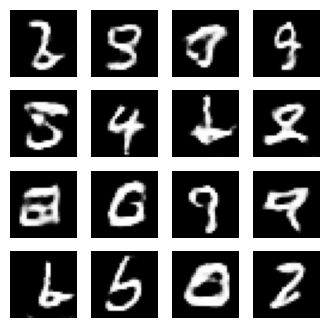

In [52]:
gen_loss_hist, disc_loss_hist = train(train_dataset, EPOCHS) #100 epochs

In [53]:
#Restore the latest checkpoint
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [54]:
#Use imageio to create an animated gif using the images saved during training
anim_file =  f"{run_dir}/dcgan.gif"

n=10

with imageio.get_writer(anim_file, mode='I', loop=n) as writer:
  filenames = glob.glob(f"{run_dir}/image_at_epoch_*.png")
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

/tmp/ipython-input-192076377.py:10: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
/tmp/ipython-input-192076377.py:12: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



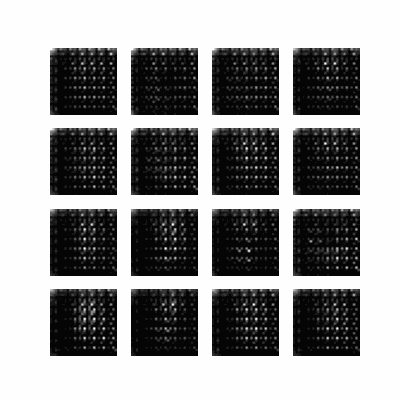

In [55]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

/tmp/ipython-input-873666131.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_start = imageio.imread(first_epoch_path)
/tmp/ipython-input-873666131.py:6: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_end = imageio.imread(final_epoch_path)


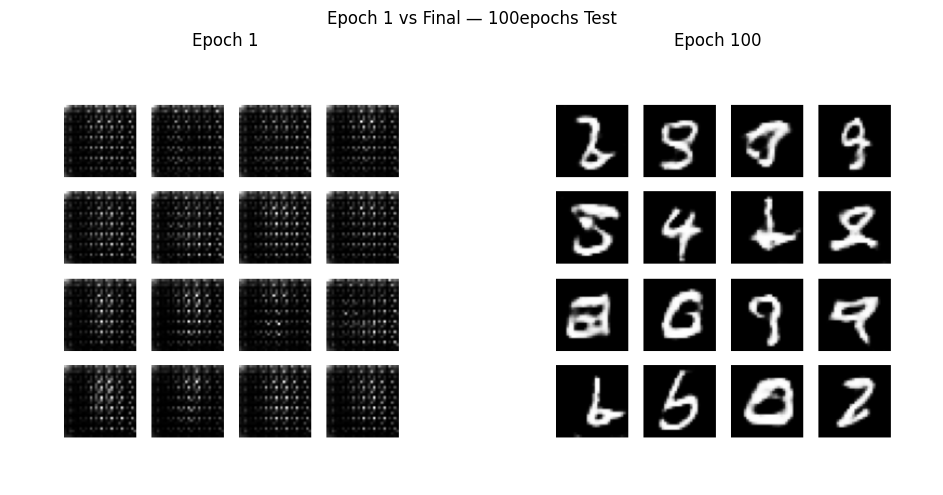

In [56]:
#Show First and Final Epoch Images
first_epoch_path = os.path.join(run_dir, "image_at_epoch_0001.png")
final_epoch_path = os.path.join(run_dir, f"image_at_epoch_{EPOCHS:04d}.png")

img_start = imageio.imread(first_epoch_path)
img_end = imageio.imread(final_epoch_path)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(img_start)
plt.title("Epoch 1")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(img_end)
plt.title(f"Epoch {EPOCHS}")
plt.axis("off")

plt.suptitle(f"Epoch 1 vs Final — {RUN_LABEL} Test")
plt.tight_layout()
plt.show()

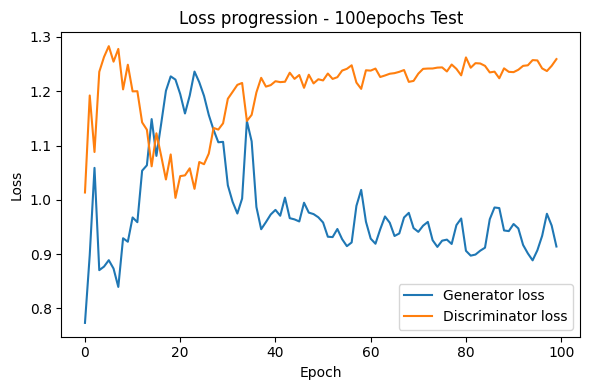

In [57]:
#Plot Loss Curves
plt.figure(figsize=(6, 4))
plt.plot(gen_loss_hist, label="Generator loss")
plt.plot(disc_loss_hist, label="Discriminator loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title(f"Loss progression - {RUN_LABEL} Test")
plt.legend()
plt.tight_layout()

loss_plot_path = f"{run_dir}/loss_curve.png"
plt.savefig(loss_plot_path)
plt.show()
plt.close()

#Modifying Generator Activations
ReLU instead of LeakyReLU

####Redefining Generator, Discriminator, Optimizers and Checkpoint

In [58]:
def make_generator_model():
  model = tf.keras.Sequential()
  model.add(layers.Dense(7*7*256, use_bias=False, input_shape=(100,)))
  model.add(layers.BatchNormalization())
  model.add(layers.ReLU())

  model.add(layers.Reshape((7, 7, 256)))
  assert model.output_shape == (None, 7, 7, 256) # Note: None is the batch size

  model.add(layers.Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same', use_bias=False))
  assert model.output_shape == (None, 7, 7, 128)
  model.add(layers.BatchNormalization())
  model.add(layers.ReLU())

  model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
  assert model.output_shape == (None, 14, 14, 64)
  model.add(layers.BatchNormalization())
  model.add(layers.ReLU())

  model.add(layers.Conv2DTranspose(1, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
  assert model.output_shape == (None, 28, 28, 1)

  return model

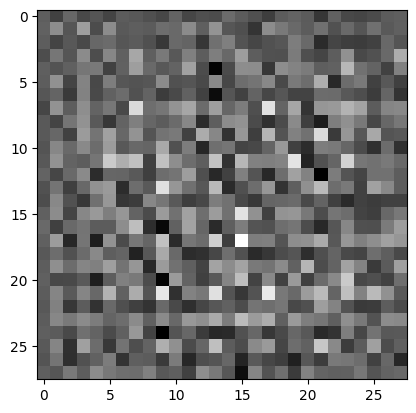

In [59]:
generator = make_generator_model()

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

In [60]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[0.00232842]], shape=(1, 1), dtype=float32)


In [61]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

In [62]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

####Training the New Model

In [63]:
#Define the training loop
EPOCHS = 50
noise_dim = 100
num_examples_to_generate = 16

#Reusing this seed overtime (so it's easier) to visualize progress in the animated GIF
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [64]:
@tf.function #to compile the function
def train_step(images):
  noise = tf.random.normal([BATCH_SIZE, noise_dim])
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_images = generator(noise, training=True)

    real_output = discriminator(images, training=True)
    fake_output = discriminator(generated_images, training=True)

    gen_loss = generator_loss(fake_output)
    disc_loss = discriminator_loss(real_output, fake_output)

  gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
  gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

  return gen_loss, disc_loss

In [65]:
def train(dataset, epochs):
  gen_loss_history = []
  disc_loss_history = []

  for epoch in range(epochs):
    start = time.time()

    epoch_gen_loss = 0.0
    epoch_disc_loss = 0.0
    batch_count = 0

    for image_batch in dataset:
      gen_loss_batch, disc_loss_batch = train_step(image_batch)

      epoch_gen_loss += float(gen_loss_batch.numpy())
      epoch_disc_loss += float(disc_loss_batch.numpy())
      batch_count += 1

    #average loss over batches
    epoch_gen_loss /= batch_count
    epoch_disc_loss /= batch_count

    gen_loss_history.append(epoch_gen_loss)
    disc_loss_history.append(epoch_disc_loss)

    #Produce images for the GIF
    display.clear_output(wait=True)
    generate_and_save_images(generator, epoch + 1, seed)

    #Save the model every 10 epochs
    if (epoch + 1) % 10 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  #Generate after the final epoch
  display.clear_output(wait=True)
  generate_and_save_images(generator, epochs, seed)

  return gen_loss_history, disc_loss_history


In [66]:
#Generate and save images
def generate_and_save_images(model, epoch, test_input):
  #training=False is so all layers run in inference mode (batchnorm)
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
    plt.subplot(4, 4, i+1)
    plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
    plt.axis('off')

  save_path = f"{run_dir}/image_at_epoch_{epoch:04d}.png"
  plt.savefig(save_path)
  plt.show()
  plt.close(fig)

In [67]:
#folder
RUN_LABEL = "ReLU"
run_dir = f"runs/{RUN_LABEL}"
os.makedirs(run_dir, exist_ok=True)

print("Saving images + GIF for this run in:", run_dir)

Saving images + GIF for this run in: runs/ReLU


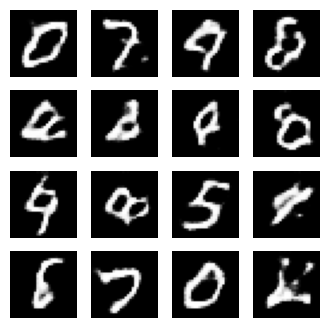

In [68]:
gen_loss_hist, disc_loss_hist = train(train_dataset, EPOCHS) #50 epochs

In [69]:
#Restore the latest checkpoint
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [70]:
#Use imageio to create an animated gif using the images saved during training
anim_file =  f"{run_dir}/dcgan.gif"

n=10

with imageio.get_writer(anim_file, mode='I', loop=n) as writer:
  filenames = glob.glob(f"{run_dir}/image_at_epoch_*.png")
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

/tmp/ipython-input-192076377.py:10: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
/tmp/ipython-input-192076377.py:12: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



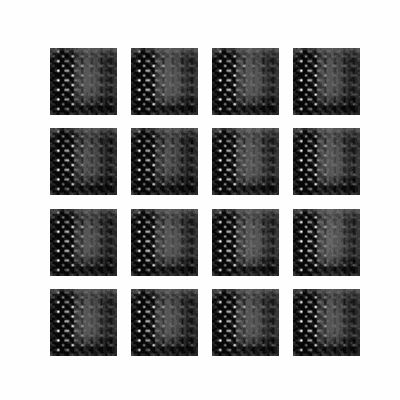

In [71]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

/tmp/ipython-input-873666131.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_start = imageio.imread(first_epoch_path)
/tmp/ipython-input-873666131.py:6: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_end = imageio.imread(final_epoch_path)


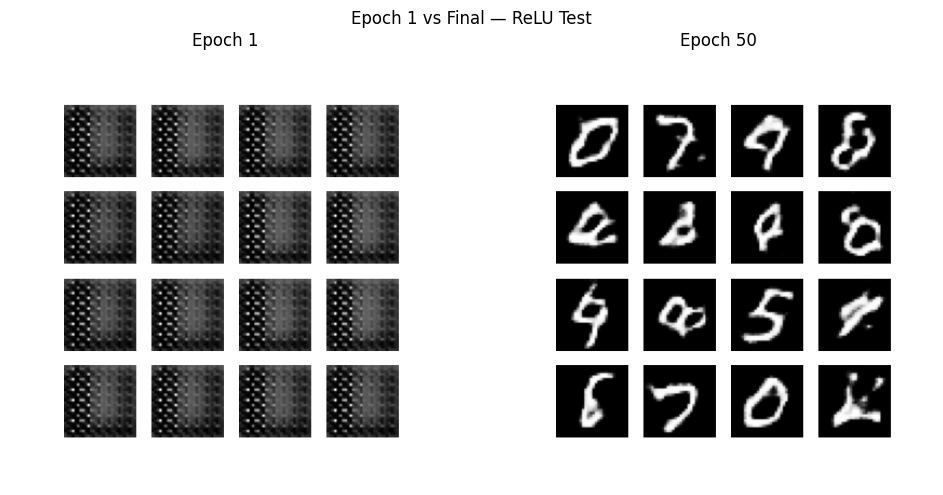

In [72]:
#Show First and Final Epoch Images
first_epoch_path = os.path.join(run_dir, "image_at_epoch_0001.png")
final_epoch_path = os.path.join(run_dir, f"image_at_epoch_{EPOCHS:04d}.png")

img_start = imageio.imread(first_epoch_path)
img_end = imageio.imread(final_epoch_path)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(img_start)
plt.title("Epoch 1")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(img_end)
plt.title(f"Epoch {EPOCHS}")
plt.axis("off")

plt.suptitle(f"Epoch 1 vs Final — {RUN_LABEL} Test")
plt.tight_layout()
plt.show()

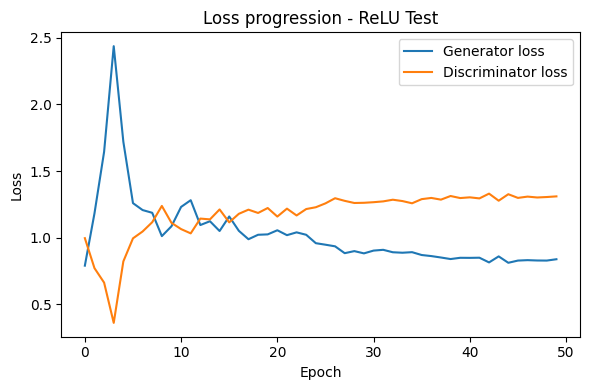

In [73]:
#Plot Loss Curves
plt.figure(figsize=(6, 4))
plt.plot(gen_loss_hist, label="Generator loss")
plt.plot(disc_loss_hist, label="Discriminator loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title(f"Loss progression - {RUN_LABEL} Test")
plt.legend()
plt.tight_layout()

loss_plot_path = f"{run_dir}/loss_curve.png"
plt.savefig(loss_plot_path)
plt.show()
plt.close()

#Hyperparameter Tuning

##Dimensionality of Noise Vector
Testing against the Baseline (noise_dim = 100)
- Test 1: noise_dim = 5
- Test 2: noise_dim = 250

###Test1

####Redefining Generator, Discriminator, Optimizers and Checkpoint

In [74]:
#Define the training loop
EPOCHS = 50
noise_dim = 5
num_examples_to_generate = 16

#Reusing this seed overtime (so it's easier) to visualize progress in the animated GIF
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [75]:
#Restore generator activation to LeakyReLU
def make_generator_model():
  model = tf.keras.Sequential()
  model.add(layers.Dense(7*7*256, use_bias=False, input_shape=(5,))) #changed input shape noise dim
  model.add(layers.BatchNormalization())
  model.add(layers.LeakyReLU())

  model.add(layers.Reshape((7, 7, 256)))
  assert model.output_shape == (None, 7, 7, 256) # Note: None is the batch size

  model.add(layers.Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same', use_bias=False))
  assert model.output_shape == (None, 7, 7, 128)
  model.add(layers.BatchNormalization())
  model.add(layers.LeakyReLU())

  model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
  assert model.output_shape == (None, 14, 14, 64)
  model.add(layers.BatchNormalization())
  model.add(layers.LeakyReLU())

  model.add(layers.Conv2DTranspose(1, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
  assert model.output_shape == (None, 28, 28, 1)

  return model

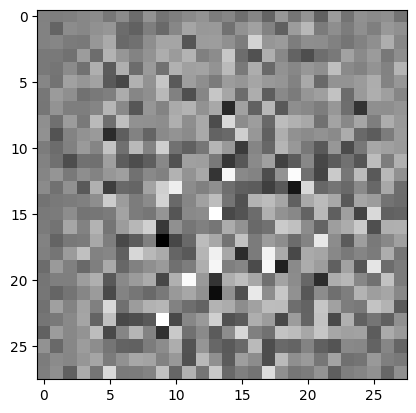

In [76]:
generator = make_generator_model()

noise = tf.random.normal([1, 5])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

In [77]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[-8.984121e-05]], shape=(1, 1), dtype=float32)


In [78]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

In [79]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

####Training the New Model

In [80]:
@tf.function #to compile the function
def train_step(images):
  noise = tf.random.normal([BATCH_SIZE, noise_dim])
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_images = generator(noise, training=True)

    real_output = discriminator(images, training=True)
    fake_output = discriminator(generated_images, training=True)

    gen_loss = generator_loss(fake_output)
    disc_loss = discriminator_loss(real_output, fake_output)

  gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
  gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

  return gen_loss, disc_loss

In [81]:
def train(dataset, epochs):
  gen_loss_history = []
  disc_loss_history = []

  for epoch in range(epochs):
    start = time.time()

    epoch_gen_loss = 0.0
    epoch_disc_loss = 0.0
    batch_count = 0

    for image_batch in dataset:
      gen_loss_batch, disc_loss_batch = train_step(image_batch)

      epoch_gen_loss += float(gen_loss_batch.numpy())
      epoch_disc_loss += float(disc_loss_batch.numpy())
      batch_count += 1

    #average loss over batches
    epoch_gen_loss /= batch_count
    epoch_disc_loss /= batch_count

    gen_loss_history.append(epoch_gen_loss)
    disc_loss_history.append(epoch_disc_loss)

    #Produce images for the GIF
    display.clear_output(wait=True)
    generate_and_save_images(generator, epoch + 1, seed)

    #Save the model every 10 epochs
    if (epoch + 1) % 10 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  #Generate after the final epoch
  display.clear_output(wait=True)
  generate_and_save_images(generator, epochs, seed)

  return gen_loss_history, disc_loss_history


In [82]:
#Generate and save images
def generate_and_save_images(model, epoch, test_input):
  #training=False is so all layers run in inference mode (batchnorm)
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
    plt.subplot(4, 4, i+1)
    plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
    plt.axis('off')

  save_path = f"{run_dir}/image_at_epoch_{epoch:04d}.png"
  plt.savefig(save_path)
  plt.show()
  plt.close(fig)

In [83]:
#folder
RUN_LABEL = "NoiseDim5"
run_dir = f"runs/{RUN_LABEL}"
os.makedirs(run_dir, exist_ok=True)

print("Saving images + GIF for this run in:", run_dir)

Saving images + GIF for this run in: runs/NoiseDim5


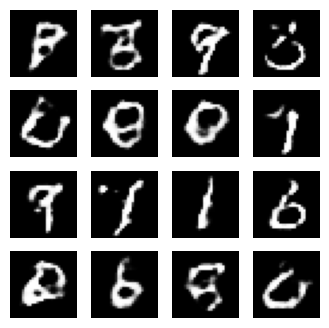

In [84]:
gen_loss_hist, disc_loss_hist = train(train_dataset, EPOCHS) #50 epochs

In [85]:
#Restore the latest checkpoint
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [86]:
#Use imageio to create an animated gif using the images saved during training
anim_file =  f"{run_dir}/dcgan.gif"

n=10

with imageio.get_writer(anim_file, mode='I', loop=n) as writer:
  filenames = glob.glob(f"{run_dir}/image_at_epoch_*.png")
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

/tmp/ipython-input-192076377.py:10: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
/tmp/ipython-input-192076377.py:12: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



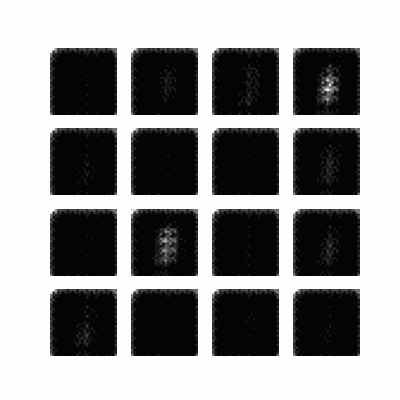

In [87]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

/tmp/ipython-input-873666131.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_start = imageio.imread(first_epoch_path)
/tmp/ipython-input-873666131.py:6: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_end = imageio.imread(final_epoch_path)


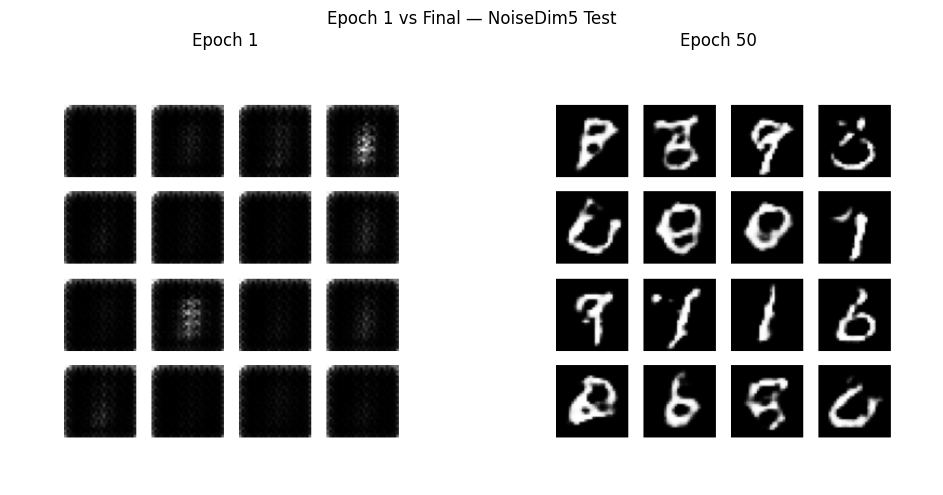

In [88]:
#Show First and Final Epoch Images
first_epoch_path = os.path.join(run_dir, "image_at_epoch_0001.png")
final_epoch_path = os.path.join(run_dir, f"image_at_epoch_{EPOCHS:04d}.png")

img_start = imageio.imread(first_epoch_path)
img_end = imageio.imread(final_epoch_path)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(img_start)
plt.title("Epoch 1")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(img_end)
plt.title(f"Epoch {EPOCHS}")
plt.axis("off")

plt.suptitle(f"Epoch 1 vs Final — {RUN_LABEL} Test")
plt.tight_layout()
plt.show()

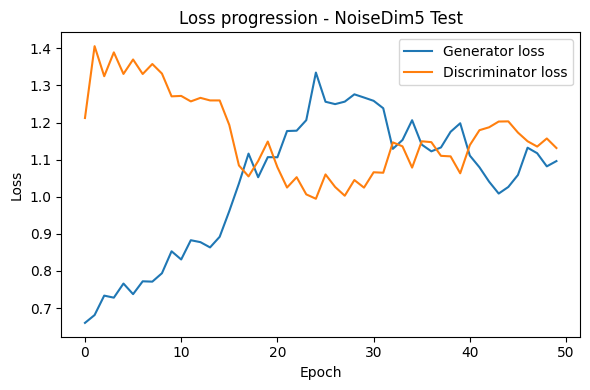

In [89]:
#Plot Loss Curves
plt.figure(figsize=(6, 4))
plt.plot(gen_loss_hist, label="Generator loss")
plt.plot(disc_loss_hist, label="Discriminator loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title(f"Loss progression - {RUN_LABEL} Test")
plt.legend()
plt.tight_layout()

loss_plot_path = f"{run_dir}/loss_curve.png"
plt.savefig(loss_plot_path)
plt.show()
plt.close()

###Test2

####Redefining Generator, Discriminator, Optimizers and Checkpoint

In [90]:
#Define the training loop
EPOCHS = 50
noise_dim = 250
num_examples_to_generate = 16

#Reusing this seed overtime (so it's easier) to visualize progress in the animated GIF
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [91]:
#Restore generator activation to LeakyReLU
def make_generator_model():
  model = tf.keras.Sequential()
  model.add(layers.Dense(7*7*256, use_bias=False, input_shape=(250,))) #changed input shape noise dim
  model.add(layers.BatchNormalization())
  model.add(layers.LeakyReLU())

  model.add(layers.Reshape((7, 7, 256)))
  assert model.output_shape == (None, 7, 7, 256) # Note: None is the batch size

  model.add(layers.Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same', use_bias=False))
  assert model.output_shape == (None, 7, 7, 128)
  model.add(layers.BatchNormalization())
  model.add(layers.LeakyReLU())

  model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
  assert model.output_shape == (None, 14, 14, 64)
  model.add(layers.BatchNormalization())
  model.add(layers.LeakyReLU())

  model.add(layers.Conv2DTranspose(1, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
  assert model.output_shape == (None, 28, 28, 1)

  return model

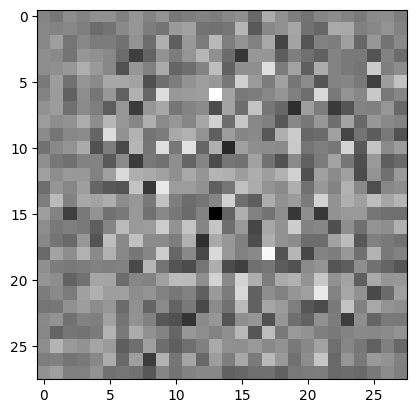

In [92]:
generator = make_generator_model()

noise = tf.random.normal([1, 250])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

In [93]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[-0.00012643]], shape=(1, 1), dtype=float32)


In [94]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

In [95]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

####Training the New Model

In [96]:
@tf.function #to compile the function
def train_step(images):
  noise = tf.random.normal([BATCH_SIZE, noise_dim])
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_images = generator(noise, training=True)

    real_output = discriminator(images, training=True)
    fake_output = discriminator(generated_images, training=True)

    gen_loss = generator_loss(fake_output)
    disc_loss = discriminator_loss(real_output, fake_output)

  gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
  gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

  return gen_loss, disc_loss

In [97]:
def train(dataset, epochs):
  gen_loss_history = []
  disc_loss_history = []

  for epoch in range(epochs):
    start = time.time()

    epoch_gen_loss = 0.0
    epoch_disc_loss = 0.0
    batch_count = 0

    for image_batch in dataset:
      gen_loss_batch, disc_loss_batch = train_step(image_batch)

      epoch_gen_loss += float(gen_loss_batch.numpy())
      epoch_disc_loss += float(disc_loss_batch.numpy())
      batch_count += 1

    #average loss over batches
    epoch_gen_loss /= batch_count
    epoch_disc_loss /= batch_count

    gen_loss_history.append(epoch_gen_loss)
    disc_loss_history.append(epoch_disc_loss)

    #Produce images for the GIF
    display.clear_output(wait=True)
    generate_and_save_images(generator, epoch + 1, seed)

    #Save the model every 10 epochs
    if (epoch + 1) % 10 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  #Generate after the final epoch
  display.clear_output(wait=True)
  generate_and_save_images(generator, epochs, seed)

  return gen_loss_history, disc_loss_history


In [98]:
#Generate and save images
def generate_and_save_images(model, epoch, test_input):
  #training=False is so all layers run in inference mode (batchnorm)
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
    plt.subplot(4, 4, i+1)
    plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
    plt.axis('off')

  save_path = f"{run_dir}/image_at_epoch_{epoch:04d}.png"
  plt.savefig(save_path)
  plt.show()
  plt.close(fig)

In [99]:
#folder
RUN_LABEL = "NoiseDim250"
run_dir = f"runs/{RUN_LABEL}"
os.makedirs(run_dir, exist_ok=True)

print("Saving images + GIF for this run in:", run_dir)

Saving images + GIF for this run in: runs/NoiseDim250


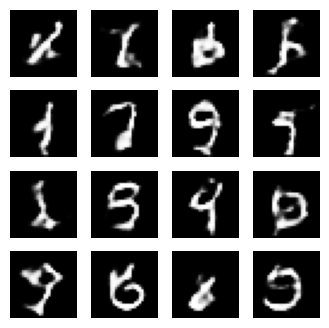

In [100]:
gen_loss_hist, disc_loss_hist = train(train_dataset, EPOCHS) #50 epochs

In [101]:
#Restore the latest checkpoint
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [102]:
#Use imageio to create an animated gif using the images saved during training
anim_file =  f"{run_dir}/dcgan.gif"

n=10

with imageio.get_writer(anim_file, mode='I', loop=n) as writer:
  filenames = glob.glob(f"{run_dir}/image_at_epoch_*.png")
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

/tmp/ipython-input-192076377.py:10: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
/tmp/ipython-input-192076377.py:12: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



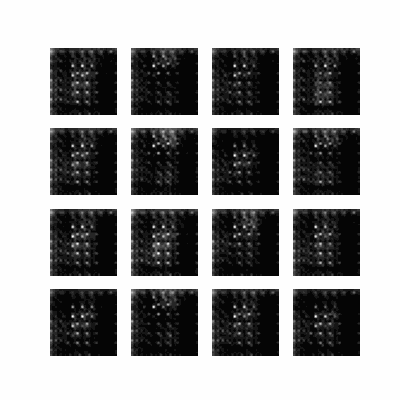

In [103]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

/tmp/ipython-input-873666131.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_start = imageio.imread(first_epoch_path)
/tmp/ipython-input-873666131.py:6: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_end = imageio.imread(final_epoch_path)


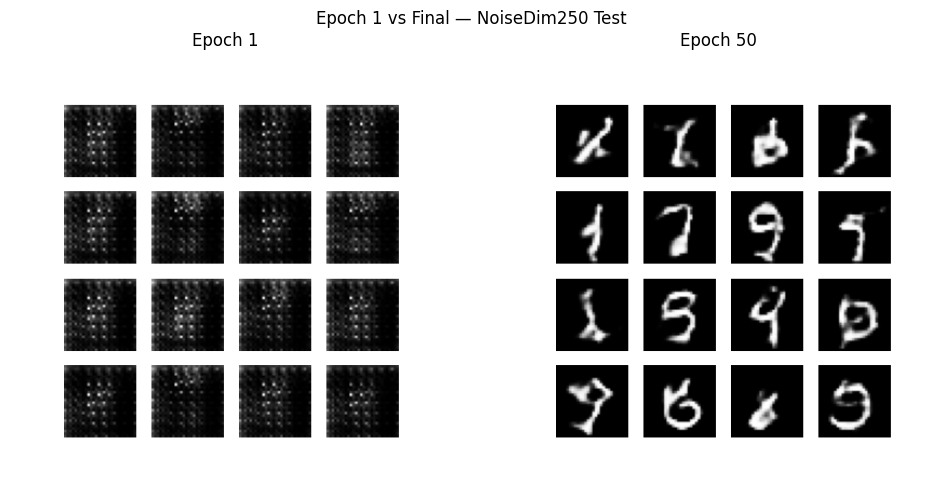

In [104]:
#Show First and Final Epoch Images
first_epoch_path = os.path.join(run_dir, "image_at_epoch_0001.png")
final_epoch_path = os.path.join(run_dir, f"image_at_epoch_{EPOCHS:04d}.png")

img_start = imageio.imread(first_epoch_path)
img_end = imageio.imread(final_epoch_path)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(img_start)
plt.title("Epoch 1")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(img_end)
plt.title(f"Epoch {EPOCHS}")
plt.axis("off")

plt.suptitle(f"Epoch 1 vs Final — {RUN_LABEL} Test")
plt.tight_layout()
plt.show()

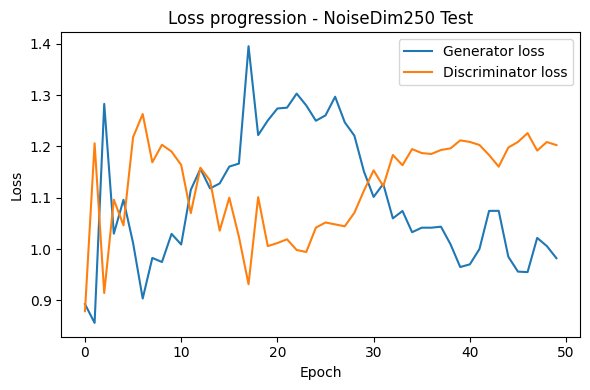

In [105]:
#Plot Loss Curves
plt.figure(figsize=(6, 4))
plt.plot(gen_loss_hist, label="Generator loss")
plt.plot(disc_loss_hist, label="Discriminator loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title(f"Loss progression - {RUN_LABEL} Test")
plt.legend()
plt.tight_layout()

loss_plot_path = f"{run_dir}/loss_curve.png"
plt.savefig(loss_plot_path)
plt.show()
plt.close()

##Batch Size
Testing against the Baseline (BATCH_SIZE = 256)
- Test 1: BATCH_SIZE = 128
- Test 2: BATCH_SIZE = 64

###Test1

In [106]:
BUFFER_SIZE = 60000
BATCH_SIZE = 128

In [107]:
#Batch and shuffle the data
train_dataset = tf.data.Dataset.from_tensor_slices(train_images).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

####Redefining Generator, Discriminator, Optimizers and Checkpoint

In [108]:
#Define the training loop
EPOCHS = 50
noise_dim = 100
num_examples_to_generate = 16

#Reusing this seed overtime (so it's easier) to visualize progress in the animated GIF
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [109]:
#Restore generator activation to LeakyReLU
def make_generator_model():
  model = tf.keras.Sequential()
  model.add(layers.Dense(7*7*256, use_bias=False, input_shape=(100,))) #reset input shape noise dim
  model.add(layers.BatchNormalization())
  model.add(layers.LeakyReLU())

  model.add(layers.Reshape((7, 7, 256)))
  assert model.output_shape == (None, 7, 7, 256) # Note: None is the batch size

  model.add(layers.Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same', use_bias=False))
  assert model.output_shape == (None, 7, 7, 128)
  model.add(layers.BatchNormalization())
  model.add(layers.LeakyReLU())

  model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
  assert model.output_shape == (None, 14, 14, 64)
  model.add(layers.BatchNormalization())
  model.add(layers.LeakyReLU())

  model.add(layers.Conv2DTranspose(1, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
  assert model.output_shape == (None, 28, 28, 1)

  return model

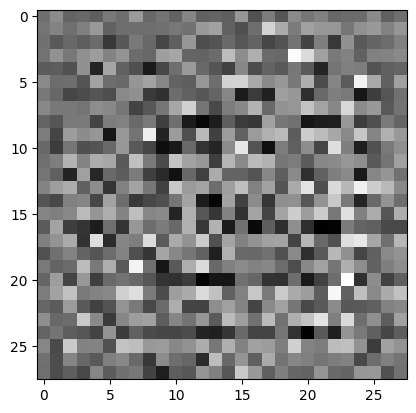

In [110]:
generator = make_generator_model()

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

In [111]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[0.00066068]], shape=(1, 1), dtype=float32)


In [112]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

In [113]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

####Training the New Model

In [114]:
@tf.function #to compile the function
def train_step(images):
  noise = tf.random.normal([BATCH_SIZE, noise_dim])
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_images = generator(noise, training=True)

    real_output = discriminator(images, training=True)
    fake_output = discriminator(generated_images, training=True)

    gen_loss = generator_loss(fake_output)
    disc_loss = discriminator_loss(real_output, fake_output)

  gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
  gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

  return gen_loss, disc_loss

In [115]:
def train(dataset, epochs):
  gen_loss_history = []
  disc_loss_history = []

  for epoch in range(epochs):
    start = time.time()

    epoch_gen_loss = 0.0
    epoch_disc_loss = 0.0
    batch_count = 0

    for image_batch in dataset:
      gen_loss_batch, disc_loss_batch = train_step(image_batch)

      epoch_gen_loss += float(gen_loss_batch.numpy())
      epoch_disc_loss += float(disc_loss_batch.numpy())
      batch_count += 1

    #average loss over batches
    epoch_gen_loss /= batch_count
    epoch_disc_loss /= batch_count

    gen_loss_history.append(epoch_gen_loss)
    disc_loss_history.append(epoch_disc_loss)

    #Produce images for the GIF
    display.clear_output(wait=True)
    generate_and_save_images(generator, epoch + 1, seed)

    #Save the model every 10 epochs
    if (epoch + 1) % 10 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  #Generate after the final epoch
  display.clear_output(wait=True)
  generate_and_save_images(generator, epochs, seed)

  return gen_loss_history, disc_loss_history


In [116]:
#Generate and save images
def generate_and_save_images(model, epoch, test_input):
  #training=False is so all layers run in inference mode (batchnorm)
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
    plt.subplot(4, 4, i+1)
    plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
    plt.axis('off')

  save_path = f"{run_dir}/image_at_epoch_{epoch:04d}.png"
  plt.savefig(save_path)
  plt.show()
  plt.close(fig)

In [117]:
#folder
RUN_LABEL = "BatchSize128"
run_dir = f"runs/{RUN_LABEL}"
os.makedirs(run_dir, exist_ok=True)

print("Saving images + GIF for this run in:", run_dir)

Saving images + GIF for this run in: runs/BatchSize128


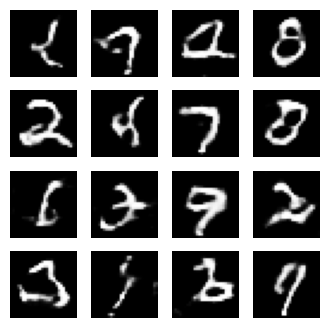

In [118]:
gen_loss_hist, disc_loss_hist = train(train_dataset, EPOCHS) #50 epochs

In [119]:
#Restore the latest checkpoint
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [120]:
#Use imageio to create an animated gif using the images saved during training
anim_file =  f"{run_dir}/dcgan.gif"

n=10

with imageio.get_writer(anim_file, mode='I', loop=n) as writer:
  filenames = glob.glob(f"{run_dir}/image_at_epoch_*.png")
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

/tmp/ipython-input-192076377.py:10: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
/tmp/ipython-input-192076377.py:12: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



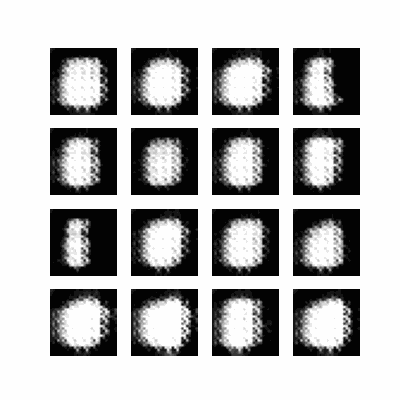

In [121]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

/tmp/ipython-input-873666131.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_start = imageio.imread(first_epoch_path)
/tmp/ipython-input-873666131.py:6: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_end = imageio.imread(final_epoch_path)


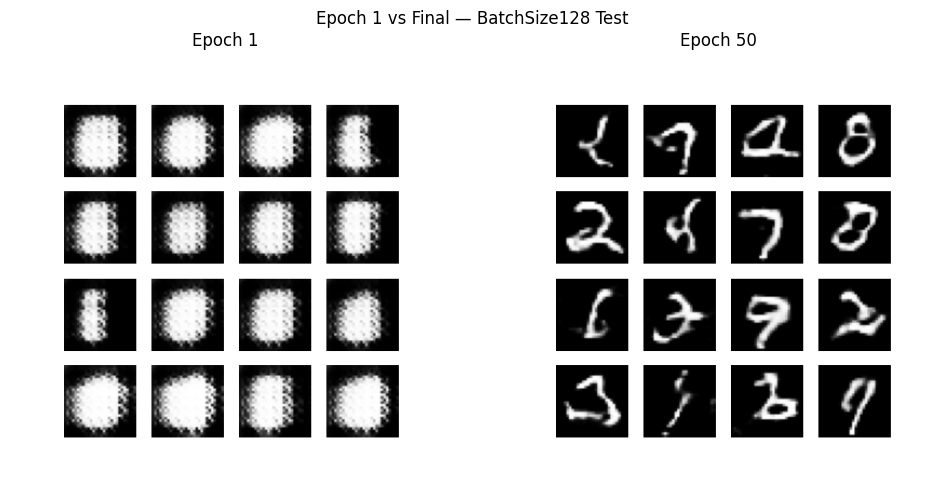

In [122]:
#Show First and Final Epoch Images
first_epoch_path = os.path.join(run_dir, "image_at_epoch_0001.png")
final_epoch_path = os.path.join(run_dir, f"image_at_epoch_{EPOCHS:04d}.png")

img_start = imageio.imread(first_epoch_path)
img_end = imageio.imread(final_epoch_path)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(img_start)
plt.title("Epoch 1")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(img_end)
plt.title(f"Epoch {EPOCHS}")
plt.axis("off")

plt.suptitle(f"Epoch 1 vs Final — {RUN_LABEL} Test")
plt.tight_layout()
plt.show()

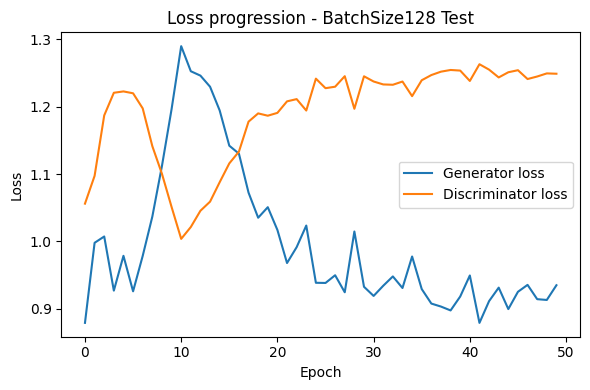

In [123]:
#Plot Loss Curves
plt.figure(figsize=(6, 4))
plt.plot(gen_loss_hist, label="Generator loss")
plt.plot(disc_loss_hist, label="Discriminator loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title(f"Loss progression - {RUN_LABEL} Test")
plt.legend()
plt.tight_layout()

loss_plot_path = f"{run_dir}/loss_curve.png"
plt.savefig(loss_plot_path)
plt.show()
plt.close()

###Test2

In [124]:
BUFFER_SIZE = 60000
BATCH_SIZE = 64

In [125]:
#Batch and shuffle the data
train_dataset = tf.data.Dataset.from_tensor_slices(train_images).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

####Redefining Generator, Discriminator, Optimizers and Checkpoint

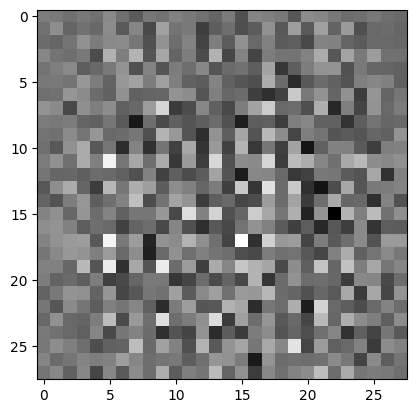

In [126]:
generator = make_generator_model()

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

In [127]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[0.00210878]], shape=(1, 1), dtype=float32)


In [128]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

In [129]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

####Training the New Model

In [130]:
#Define the training loop
EPOCHS = 50
noise_dim = 100
num_examples_to_generate = 16

#Reusing this seed overtime (so it's easier) to visualize progress in the animated GIF
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [131]:
@tf.function #to compile the function
def train_step(images):
  noise = tf.random.normal([BATCH_SIZE, noise_dim])
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_images = generator(noise, training=True)

    real_output = discriminator(images, training=True)
    fake_output = discriminator(generated_images, training=True)

    gen_loss = generator_loss(fake_output)
    disc_loss = discriminator_loss(real_output, fake_output)

  gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
  gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

  return gen_loss, disc_loss

In [132]:
def train(dataset, epochs):
  gen_loss_history = []
  disc_loss_history = []

  for epoch in range(epochs):
    start = time.time()

    epoch_gen_loss = 0.0
    epoch_disc_loss = 0.0
    batch_count = 0

    for image_batch in dataset:
      gen_loss_batch, disc_loss_batch = train_step(image_batch)

      epoch_gen_loss += float(gen_loss_batch.numpy())
      epoch_disc_loss += float(disc_loss_batch.numpy())
      batch_count += 1

    #average loss over batches
    epoch_gen_loss /= batch_count
    epoch_disc_loss /= batch_count

    gen_loss_history.append(epoch_gen_loss)
    disc_loss_history.append(epoch_disc_loss)

    #Produce images for the GIF
    display.clear_output(wait=True)
    generate_and_save_images(generator, epoch + 1, seed)

    #Save the model every 10 epochs
    if (epoch + 1) % 10 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  #Generate after the final epoch
  display.clear_output(wait=True)
  generate_and_save_images(generator, epochs, seed)

  return gen_loss_history, disc_loss_history


In [133]:
#Generate and save images
def generate_and_save_images(model, epoch, test_input):
  #training=False is so all layers run in inference mode (batchnorm)
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
    plt.subplot(4, 4, i+1)
    plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
    plt.axis('off')

  save_path = f"{run_dir}/image_at_epoch_{epoch:04d}.png"
  plt.savefig(save_path)
  plt.show()
  plt.close(fig)

In [134]:
#folder
RUN_LABEL = "BatchSize64"
run_dir = f"runs/{RUN_LABEL}"
os.makedirs(run_dir, exist_ok=True)

print("Saving images + GIF for this run in:", run_dir)

Saving images + GIF for this run in: runs/BatchSize64


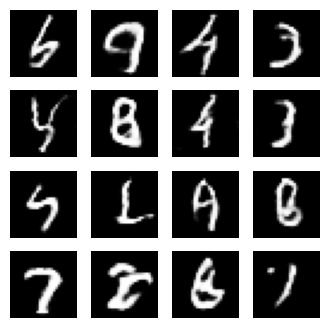

In [135]:
gen_loss_hist, disc_loss_hist = train(train_dataset, EPOCHS) #50 epochs

In [136]:
#Restore the latest checkpoint
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [137]:
#Use imageio to create an animated gif using the images saved during training
anim_file =  f"{run_dir}/dcgan.gif"

n=10

with imageio.get_writer(anim_file, mode='I', loop=n) as writer:
  filenames = glob.glob(f"{run_dir}/image_at_epoch_*.png")
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

/tmp/ipython-input-192076377.py:10: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
/tmp/ipython-input-192076377.py:12: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



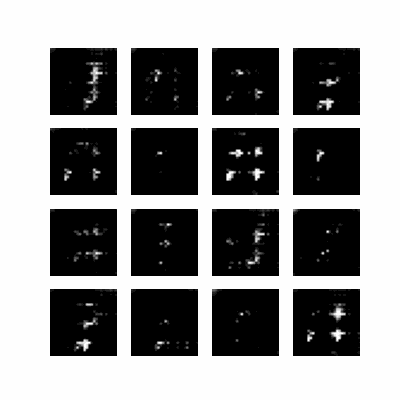

In [138]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

/tmp/ipython-input-873666131.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_start = imageio.imread(first_epoch_path)
/tmp/ipython-input-873666131.py:6: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_end = imageio.imread(final_epoch_path)


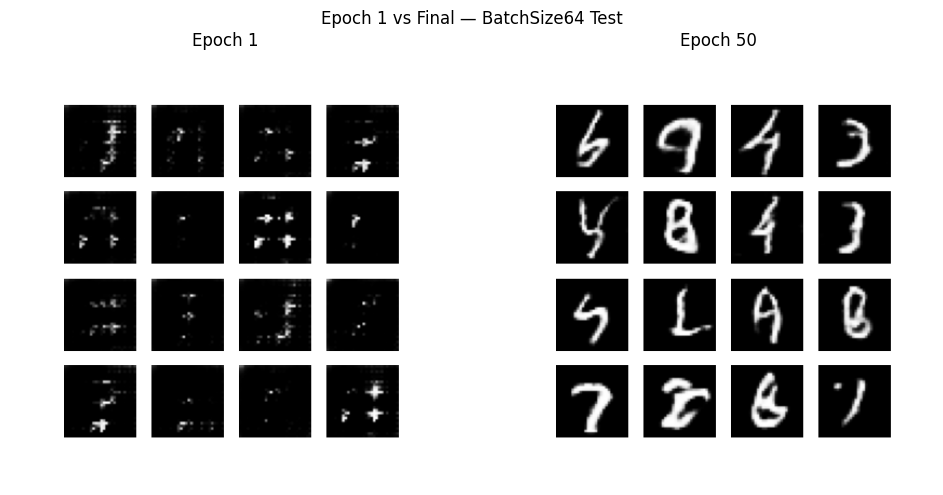

In [139]:
#Show First and Final Epoch Images
first_epoch_path = os.path.join(run_dir, "image_at_epoch_0001.png")
final_epoch_path = os.path.join(run_dir, f"image_at_epoch_{EPOCHS:04d}.png")

img_start = imageio.imread(first_epoch_path)
img_end = imageio.imread(final_epoch_path)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(img_start)
plt.title("Epoch 1")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(img_end)
plt.title(f"Epoch {EPOCHS}")
plt.axis("off")

plt.suptitle(f"Epoch 1 vs Final — {RUN_LABEL} Test")
plt.tight_layout()
plt.show()

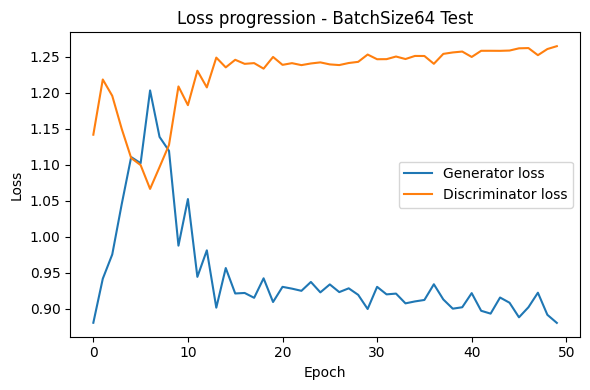

In [140]:
#Plot Loss Curves
plt.figure(figsize=(6, 4))
plt.plot(gen_loss_hist, label="Generator loss")
plt.plot(disc_loss_hist, label="Discriminator loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title(f"Loss progression - {RUN_LABEL} Test")
plt.legend()
plt.tight_layout()

loss_plot_path = f"{run_dir}/loss_curve.png"
plt.savefig(loss_plot_path)
plt.show()
plt.close()

##Learning Rates
Testing against the Baseline (AllLearningRates = 1e-4 [0.0001])
- Test 1: AllLearningRates = 5e-5
- Test 2: AllLearningRates = 2e-4
- Test 3: GeneratorLR = 2e-4 DiscriminatorLR = 1e-4
- Test 4: GeneratorLR = 1e-4 DiscriminatorLR = 2e-4

###Test1

In [141]:
BUFFER_SIZE = 60000
BATCH_SIZE = 256 #Resetting Batch Size to Baseline

In [142]:
#Batch and shuffle the data
train_dataset = tf.data.Dataset.from_tensor_slices(train_images).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

####Redefining Generator, Discriminator, Optimizers and Checkpoint

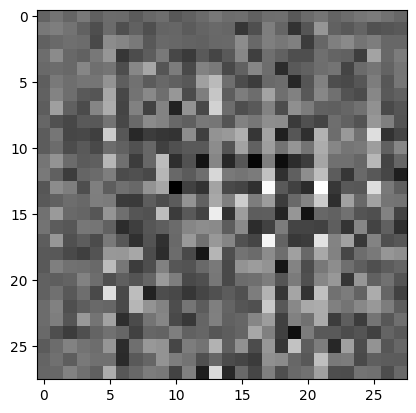

In [143]:
generator = make_generator_model()

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

In [144]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[-0.00141515]], shape=(1, 1), dtype=float32)


In [145]:
generator_optimizer = tf.keras.optimizers.Adam(5e-5)
discriminator_optimizer = tf.keras.optimizers.Adam(5e-5)

In [146]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

####Training the New Model

In [147]:
#Define the training loop
EPOCHS = 50
noise_dim = 100
num_examples_to_generate = 16

#Reusing this seed overtime (so it's easier) to visualize progress in the animated GIF
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [148]:
@tf.function #to compile the function
def train_step(images):
  noise = tf.random.normal([BATCH_SIZE, noise_dim])
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_images = generator(noise, training=True)

    real_output = discriminator(images, training=True)
    fake_output = discriminator(generated_images, training=True)

    gen_loss = generator_loss(fake_output)
    disc_loss = discriminator_loss(real_output, fake_output)

  gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
  gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

  return gen_loss, disc_loss

In [149]:
def train(dataset, epochs):
  gen_loss_history = []
  disc_loss_history = []

  for epoch in range(epochs):
    start = time.time()

    epoch_gen_loss = 0.0
    epoch_disc_loss = 0.0
    batch_count = 0

    for image_batch in dataset:
      gen_loss_batch, disc_loss_batch = train_step(image_batch)

      epoch_gen_loss += float(gen_loss_batch.numpy())
      epoch_disc_loss += float(disc_loss_batch.numpy())
      batch_count += 1

    #average loss over batches
    epoch_gen_loss /= batch_count
    epoch_disc_loss /= batch_count

    gen_loss_history.append(epoch_gen_loss)
    disc_loss_history.append(epoch_disc_loss)

    #Produce images for the GIF
    display.clear_output(wait=True)
    generate_and_save_images(generator, epoch + 1, seed)

    #Save the model every 10 epochs
    if (epoch + 1) % 10 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  #Generate after the final epoch
  display.clear_output(wait=True)
  generate_and_save_images(generator, epochs, seed)

  return gen_loss_history, disc_loss_history


In [150]:
#Generate and save images
def generate_and_save_images(model, epoch, test_input):
  #training=False is so all layers run in inference mode (batchnorm)
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
    plt.subplot(4, 4, i+1)
    plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
    plt.axis('off')

  save_path = f"{run_dir}/image_at_epoch_{epoch:04d}.png"
  plt.savefig(save_path)
  plt.show()
  plt.close(fig)

In [151]:
#folder
RUN_LABEL = "AllLR(5e-5)"
run_dir = f"runs/{RUN_LABEL}"
os.makedirs(run_dir, exist_ok=True)

print("Saving images + GIF for this run in:", run_dir)

Saving images + GIF for this run in: runs/AllLR(5e-5)


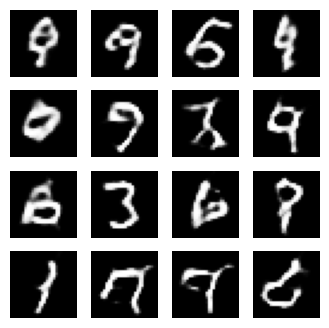

In [152]:
gen_loss_hist, disc_loss_hist = train(train_dataset, EPOCHS) #50 epochs

In [153]:
#Restore the latest checkpoint
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [154]:
#Use imageio to create an animated gif using the images saved during training
anim_file =  f"{run_dir}/dcgan.gif"

n=10

with imageio.get_writer(anim_file, mode='I', loop=n) as writer:
  filenames = glob.glob(f"{run_dir}/image_at_epoch_*.png")
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

/tmp/ipython-input-192076377.py:10: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
/tmp/ipython-input-192076377.py:12: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



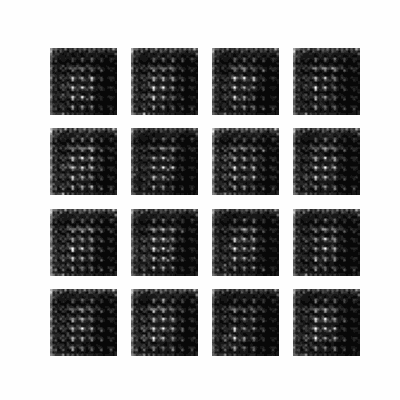

In [155]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

/tmp/ipython-input-873666131.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_start = imageio.imread(first_epoch_path)
/tmp/ipython-input-873666131.py:6: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_end = imageio.imread(final_epoch_path)


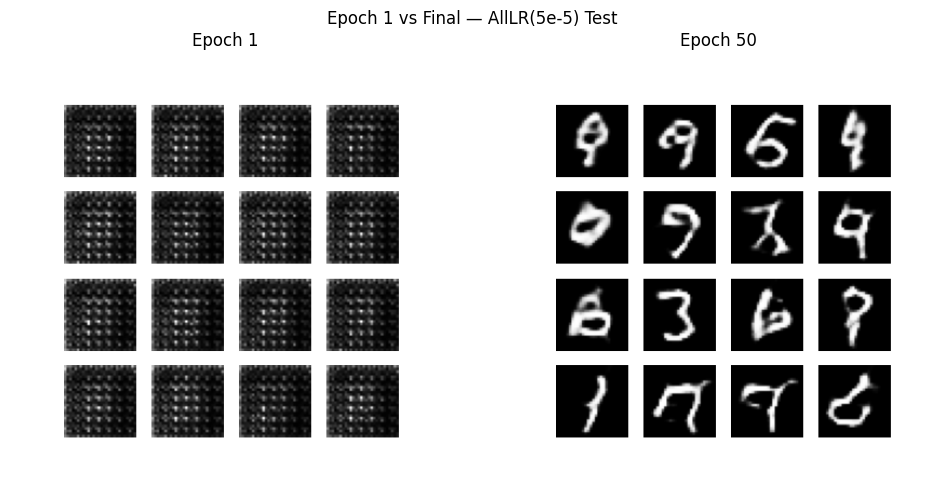

In [156]:
#Show First and Final Epoch Images
first_epoch_path = os.path.join(run_dir, "image_at_epoch_0001.png")
final_epoch_path = os.path.join(run_dir, f"image_at_epoch_{EPOCHS:04d}.png")

img_start = imageio.imread(first_epoch_path)
img_end = imageio.imread(final_epoch_path)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(img_start)
plt.title("Epoch 1")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(img_end)
plt.title(f"Epoch {EPOCHS}")
plt.axis("off")

plt.suptitle(f"Epoch 1 vs Final — {RUN_LABEL} Test")
plt.tight_layout()
plt.show()

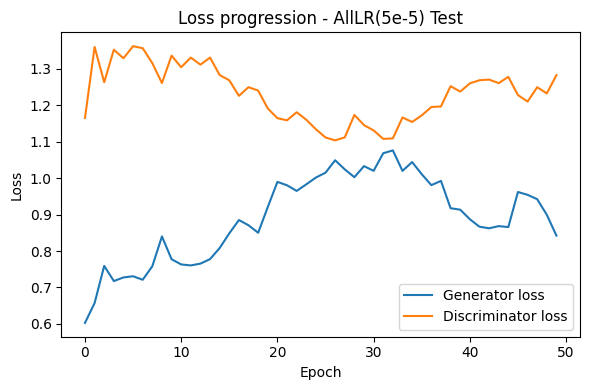

In [157]:
#Plot Loss Curves
plt.figure(figsize=(6, 4))
plt.plot(gen_loss_hist, label="Generator loss")
plt.plot(disc_loss_hist, label="Discriminator loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title(f"Loss progression - {RUN_LABEL} Test")
plt.legend()
plt.tight_layout()

loss_plot_path = f"{run_dir}/loss_curve.png"
plt.savefig(loss_plot_path)
plt.show()
plt.close()

###Test2

####Redefining Generator, Discriminator, Optimizers and Checkpoint

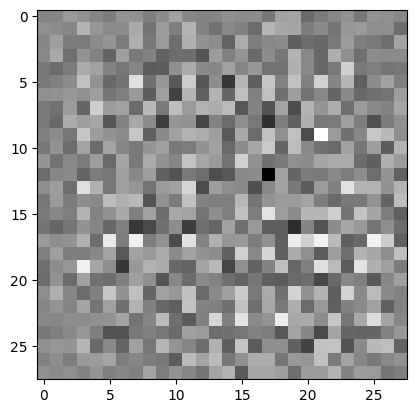

In [158]:
generator = make_generator_model()

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

In [159]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[-5.8328966e-05]], shape=(1, 1), dtype=float32)


In [160]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4)

In [161]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

####Training the New Model

In [162]:
#Define the training loop
EPOCHS = 50
noise_dim = 100
num_examples_to_generate = 16

#Reusing this seed overtime (so it's easier) to visualize progress in the animated GIF
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [163]:
@tf.function #to compile the function
def train_step(images):
  noise = tf.random.normal([BATCH_SIZE, noise_dim])
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_images = generator(noise, training=True)

    real_output = discriminator(images, training=True)
    fake_output = discriminator(generated_images, training=True)

    gen_loss = generator_loss(fake_output)
    disc_loss = discriminator_loss(real_output, fake_output)

  gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
  gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

  return gen_loss, disc_loss

In [164]:
def train(dataset, epochs):
  gen_loss_history = []
  disc_loss_history = []

  for epoch in range(epochs):
    start = time.time()

    epoch_gen_loss = 0.0
    epoch_disc_loss = 0.0
    batch_count = 0

    for image_batch in dataset:
      gen_loss_batch, disc_loss_batch = train_step(image_batch)

      epoch_gen_loss += float(gen_loss_batch.numpy())
      epoch_disc_loss += float(disc_loss_batch.numpy())
      batch_count += 1

    #average loss over batches
    epoch_gen_loss /= batch_count
    epoch_disc_loss /= batch_count

    gen_loss_history.append(epoch_gen_loss)
    disc_loss_history.append(epoch_disc_loss)

    #Produce images for the GIF
    display.clear_output(wait=True)
    generate_and_save_images(generator, epoch + 1, seed)

    #Save the model every 10 epochs
    if (epoch + 1) % 10 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  #Generate after the final epoch
  display.clear_output(wait=True)
  generate_and_save_images(generator, epochs, seed)

  return gen_loss_history, disc_loss_history


In [165]:
#Generate and save images
def generate_and_save_images(model, epoch, test_input):
  #training=False is so all layers run in inference mode (batchnorm)
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
    plt.subplot(4, 4, i+1)
    plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
    plt.axis('off')

  save_path = f"{run_dir}/image_at_epoch_{epoch:04d}.png"
  plt.savefig(save_path)
  plt.show()
  plt.close(fig)

In [166]:
#folder
RUN_LABEL = "AllLR(2e-4)"
run_dir = f"runs/{RUN_LABEL}"
os.makedirs(run_dir, exist_ok=True)

print("Saving images + GIF for this run in:", run_dir)

Saving images + GIF for this run in: runs/AllLR(2e-4)


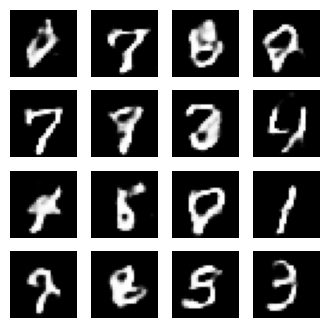

In [167]:
gen_loss_hist, disc_loss_hist = train(train_dataset, EPOCHS) #50 epochs

In [168]:
#Restore the latest checkpoint
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [169]:
#Use imageio to create an animated gif using the images saved during training
anim_file =  f"{run_dir}/dcgan.gif"

n=10

with imageio.get_writer(anim_file, mode='I', loop=n) as writer:
  filenames = glob.glob(f"{run_dir}/image_at_epoch_*.png")
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

/tmp/ipython-input-192076377.py:10: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
/tmp/ipython-input-192076377.py:12: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



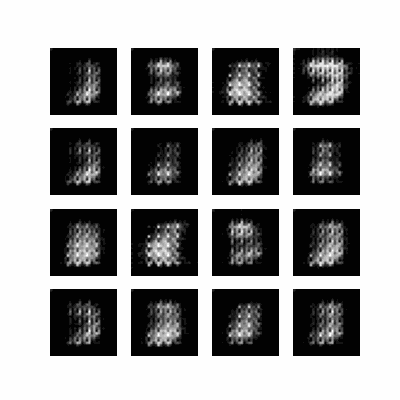

In [170]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

/tmp/ipython-input-873666131.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_start = imageio.imread(first_epoch_path)
/tmp/ipython-input-873666131.py:6: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_end = imageio.imread(final_epoch_path)


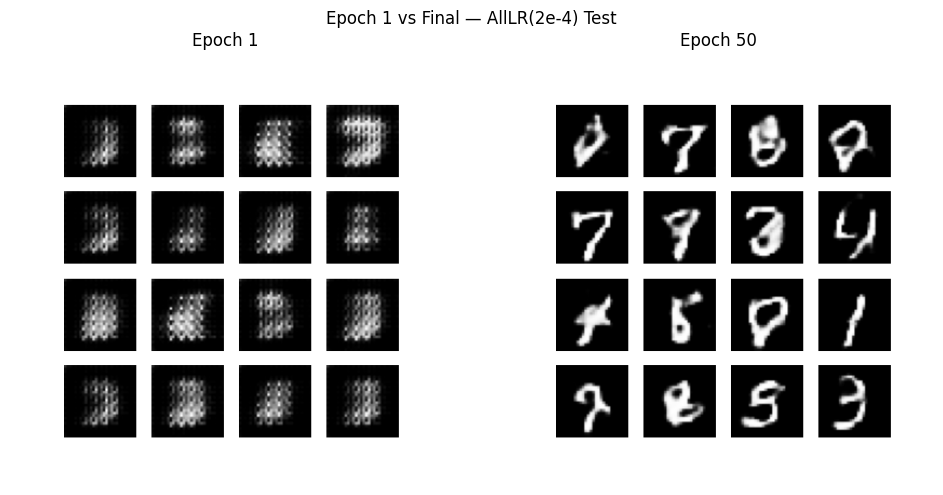

In [171]:
#Show First and Final Epoch Images
first_epoch_path = os.path.join(run_dir, "image_at_epoch_0001.png")
final_epoch_path = os.path.join(run_dir, f"image_at_epoch_{EPOCHS:04d}.png")

img_start = imageio.imread(first_epoch_path)
img_end = imageio.imread(final_epoch_path)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(img_start)
plt.title("Epoch 1")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(img_end)
plt.title(f"Epoch {EPOCHS}")
plt.axis("off")

plt.suptitle(f"Epoch 1 vs Final — {RUN_LABEL} Test")
plt.tight_layout()
plt.show()

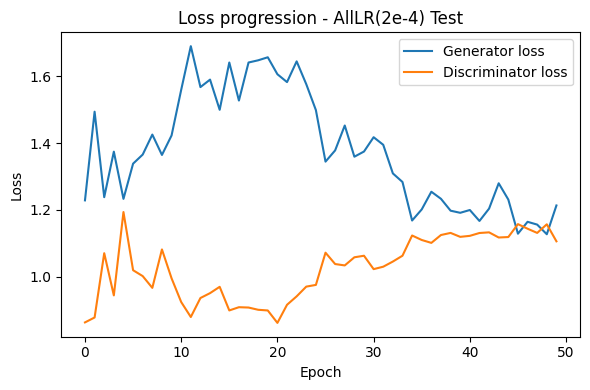

In [172]:
#Plot Loss Curves
plt.figure(figsize=(6, 4))
plt.plot(gen_loss_hist, label="Generator loss")
plt.plot(disc_loss_hist, label="Discriminator loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title(f"Loss progression - {RUN_LABEL} Test")
plt.legend()
plt.tight_layout()

loss_plot_path = f"{run_dir}/loss_curve.png"
plt.savefig(loss_plot_path)
plt.show()
plt.close()

###Test3

####Redefining Generator, Discriminator, Optimizers and Checkpoint

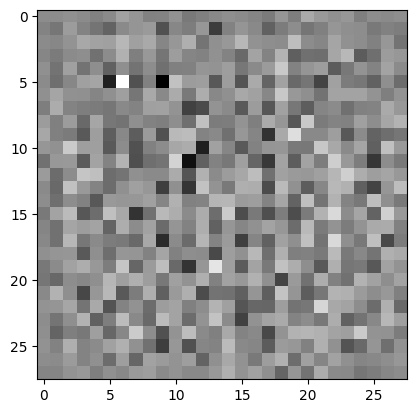

In [173]:
generator = make_generator_model()

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

In [174]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[-0.00072113]], shape=(1, 1), dtype=float32)


In [175]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

In [176]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

####Training the New Model

In [177]:
#Define the training loop
EPOCHS = 50
noise_dim = 100
num_examples_to_generate = 16

#Reusing this seed overtime (so it's easier) to visualize progress in the animated GIF
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [178]:
@tf.function #to compile the function
def train_step(images):
  noise = tf.random.normal([BATCH_SIZE, noise_dim])
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_images = generator(noise, training=True)

    real_output = discriminator(images, training=True)
    fake_output = discriminator(generated_images, training=True)

    gen_loss = generator_loss(fake_output)
    disc_loss = discriminator_loss(real_output, fake_output)

  gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
  gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

  return gen_loss, disc_loss

In [179]:
def train(dataset, epochs):
  gen_loss_history = []
  disc_loss_history = []

  for epoch in range(epochs):
    start = time.time()

    epoch_gen_loss = 0.0
    epoch_disc_loss = 0.0
    batch_count = 0

    for image_batch in dataset:
      gen_loss_batch, disc_loss_batch = train_step(image_batch)

      epoch_gen_loss += float(gen_loss_batch.numpy())
      epoch_disc_loss += float(disc_loss_batch.numpy())
      batch_count += 1

    #average loss over batches
    epoch_gen_loss /= batch_count
    epoch_disc_loss /= batch_count

    gen_loss_history.append(epoch_gen_loss)
    disc_loss_history.append(epoch_disc_loss)

    #Produce images for the GIF
    display.clear_output(wait=True)
    generate_and_save_images(generator, epoch + 1, seed)

    #Save the model every 10 epochs
    if (epoch + 1) % 10 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  #Generate after the final epoch
  display.clear_output(wait=True)
  generate_and_save_images(generator, epochs, seed)

  return gen_loss_history, disc_loss_history


In [180]:
#Generate and save images
def generate_and_save_images(model, epoch, test_input):
  #training=False is so all layers run in inference mode (batchnorm)
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
    plt.subplot(4, 4, i+1)
    plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
    plt.axis('off')

  save_path = f"{run_dir}/image_at_epoch_{epoch:04d}.png"
  plt.savefig(save_path)
  plt.show()
  plt.close(fig)

In [181]:
#folder
RUN_LABEL = "GenLR(2e-4)_DisLR(1e-4)"
run_dir = f"runs/{RUN_LABEL}"
os.makedirs(run_dir, exist_ok=True)

print("Saving images + GIF for this run in:", run_dir)

Saving images + GIF for this run in: runs/GenLR(2e-4)_DisLR(1e-4)


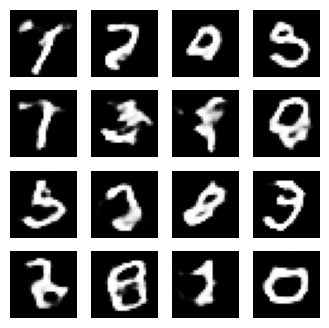

In [182]:
gen_loss_hist, disc_loss_hist = train(train_dataset, EPOCHS) #50 epochs

In [183]:
#Restore the latest checkpoint
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [184]:
#Use imageio to create an animated gif using the images saved during training
anim_file =  f"{run_dir}/dcgan.gif"

n=10

with imageio.get_writer(anim_file, mode='I', loop=n) as writer:
  filenames = glob.glob(f"{run_dir}/image_at_epoch_*.png")
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

/tmp/ipython-input-192076377.py:10: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
/tmp/ipython-input-192076377.py:12: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



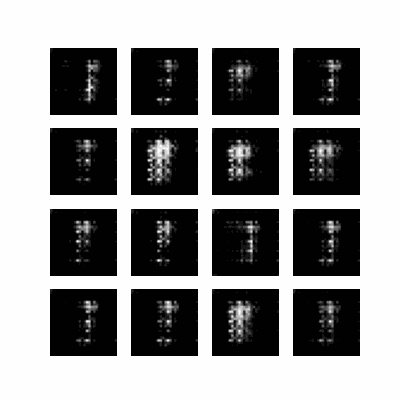

In [185]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

/tmp/ipython-input-873666131.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_start = imageio.imread(first_epoch_path)
/tmp/ipython-input-873666131.py:6: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_end = imageio.imread(final_epoch_path)


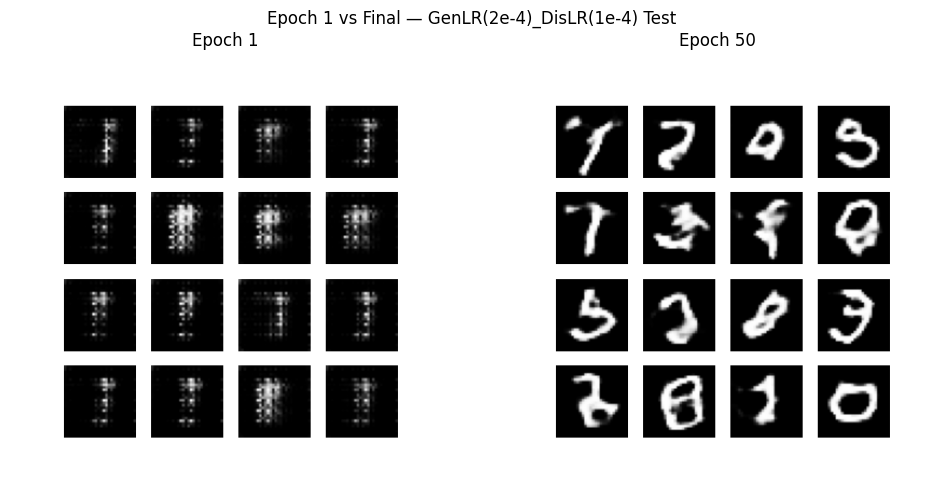

In [186]:
#Show First and Final Epoch Images
first_epoch_path = os.path.join(run_dir, "image_at_epoch_0001.png")
final_epoch_path = os.path.join(run_dir, f"image_at_epoch_{EPOCHS:04d}.png")

img_start = imageio.imread(first_epoch_path)
img_end = imageio.imread(final_epoch_path)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(img_start)
plt.title("Epoch 1")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(img_end)
plt.title(f"Epoch {EPOCHS}")
plt.axis("off")

plt.suptitle(f"Epoch 1 vs Final — {RUN_LABEL} Test")
plt.tight_layout()
plt.show()

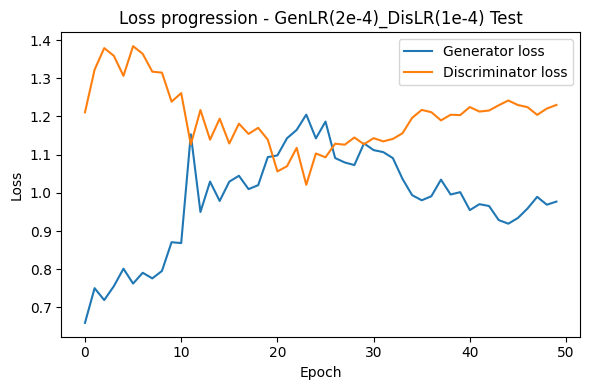

In [187]:
#Plot Loss Curves
plt.figure(figsize=(6, 4))
plt.plot(gen_loss_hist, label="Generator loss")
plt.plot(disc_loss_hist, label="Discriminator loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title(f"Loss progression - {RUN_LABEL} Test")
plt.legend()
plt.tight_layout()

loss_plot_path = f"{run_dir}/loss_curve.png"
plt.savefig(loss_plot_path)
plt.show()
plt.close()

###Test4

####Redefining Generator, Discriminator, Optimizers and Checkpoint

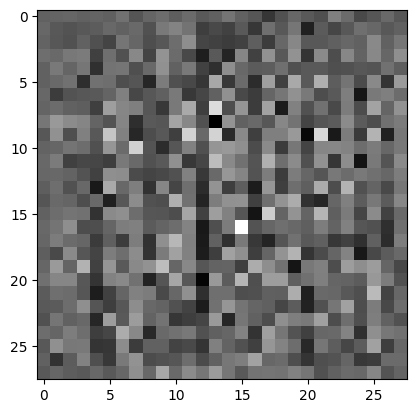

In [188]:
generator = make_generator_model()

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

In [189]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[0.00034365]], shape=(1, 1), dtype=float32)


In [190]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4)

In [191]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

####Training the New Model

In [192]:
#Define the training loop
EPOCHS = 50
noise_dim = 100
num_examples_to_generate = 16

#Reusing this seed overtime (so it's easier) to visualize progress in the animated GIF
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [193]:
@tf.function #to compile the function
def train_step(images):
  noise = tf.random.normal([BATCH_SIZE, noise_dim])
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_images = generator(noise, training=True)

    real_output = discriminator(images, training=True)
    fake_output = discriminator(generated_images, training=True)

    gen_loss = generator_loss(fake_output)
    disc_loss = discriminator_loss(real_output, fake_output)

  gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
  gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

  return gen_loss, disc_loss

In [194]:
def train(dataset, epochs):
  gen_loss_history = []
  disc_loss_history = []

  for epoch in range(epochs):
    start = time.time()

    epoch_gen_loss = 0.0
    epoch_disc_loss = 0.0
    batch_count = 0

    for image_batch in dataset:
      gen_loss_batch, disc_loss_batch = train_step(image_batch)

      epoch_gen_loss += float(gen_loss_batch.numpy())
      epoch_disc_loss += float(disc_loss_batch.numpy())
      batch_count += 1

    #average loss over batches
    epoch_gen_loss /= batch_count
    epoch_disc_loss /= batch_count

    gen_loss_history.append(epoch_gen_loss)
    disc_loss_history.append(epoch_disc_loss)

    #Produce images for the GIF
    display.clear_output(wait=True)
    generate_and_save_images(generator, epoch + 1, seed)

    #Save the model every 10 epochs
    if (epoch + 1) % 10 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  #Generate after the final epoch
  display.clear_output(wait=True)
  generate_and_save_images(generator, epochs, seed)

  return gen_loss_history, disc_loss_history


In [195]:
#Generate and save images
def generate_and_save_images(model, epoch, test_input):
  #training=False is so all layers run in inference mode (batchnorm)
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
    plt.subplot(4, 4, i+1)
    plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
    plt.axis('off')

  save_path = f"{run_dir}/image_at_epoch_{epoch:04d}.png"
  plt.savefig(save_path)
  plt.show()
  plt.close(fig)

In [196]:
#folder
RUN_LABEL = "GenLR(1e-4)_DisLR(2e-4)"
run_dir = f"runs/{RUN_LABEL}"
os.makedirs(run_dir, exist_ok=True)

print("Saving images + GIF for this run in:", run_dir)

Saving images + GIF for this run in: runs/GenLR(1e-4)_DisLR(2e-4)


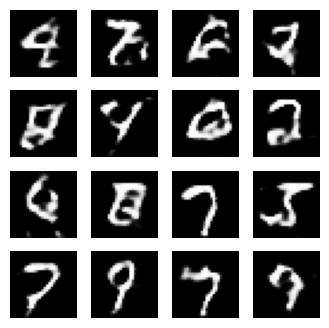

In [197]:
gen_loss_hist, disc_loss_hist = train(train_dataset, EPOCHS) #50 epochs

In [198]:
#Restore the latest checkpoint
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [199]:
#Use imageio to create an animated gif using the images saved during training
anim_file =  f"{run_dir}/dcgan.gif"

n=10

with imageio.get_writer(anim_file, mode='I', loop=n) as writer:
  filenames = glob.glob(f"{run_dir}/image_at_epoch_*.png")
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

/tmp/ipython-input-192076377.py:10: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
/tmp/ipython-input-192076377.py:12: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



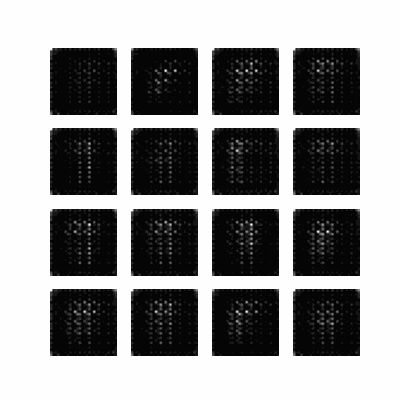

In [200]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

/tmp/ipython-input-873666131.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_start = imageio.imread(first_epoch_path)
/tmp/ipython-input-873666131.py:6: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_end = imageio.imread(final_epoch_path)


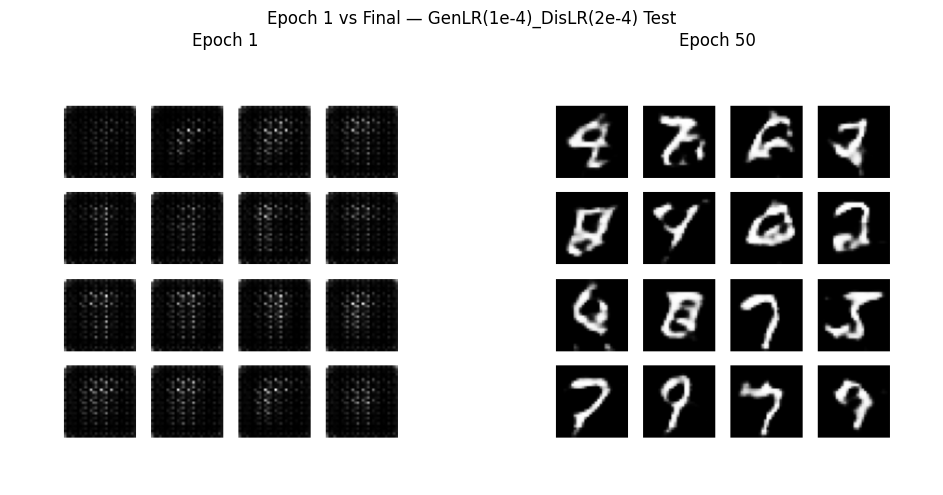

In [201]:
#Show First and Final Epoch Images
first_epoch_path = os.path.join(run_dir, "image_at_epoch_0001.png")
final_epoch_path = os.path.join(run_dir, f"image_at_epoch_{EPOCHS:04d}.png")

img_start = imageio.imread(first_epoch_path)
img_end = imageio.imread(final_epoch_path)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(img_start)
plt.title("Epoch 1")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(img_end)
plt.title(f"Epoch {EPOCHS}")
plt.axis("off")

plt.suptitle(f"Epoch 1 vs Final — {RUN_LABEL} Test")
plt.tight_layout()
plt.show()

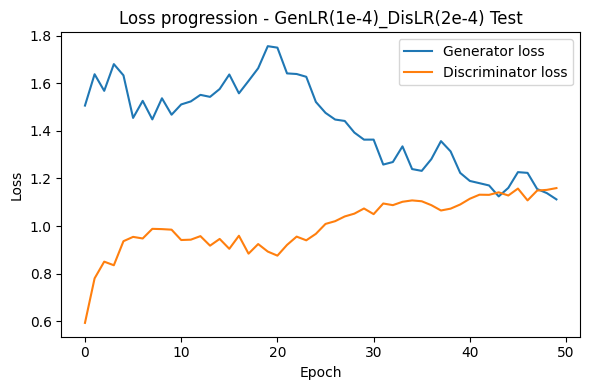

In [202]:
#Plot Loss Curves
plt.figure(figsize=(6, 4))
plt.plot(gen_loss_hist, label="Generator loss")
plt.plot(disc_loss_hist, label="Discriminator loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title(f"Loss progression - {RUN_LABEL} Test")
plt.legend()
plt.tight_layout()

loss_plot_path = f"{run_dir}/loss_curve.png"
plt.savefig(loss_plot_path)
plt.show()
plt.close()

##Learning Rates (0)
Testing against the Baseline (AllLearningRates = 1e-4 [0.0001])
- Test 1: AllLearningRates = 1e-3
- Test 2: AllLearningRates = 1e-5
- Test 3: GeneratorLR = 1e-5 DiscriminatorLR = 1e-4
- Test 4: GeneratorLR = 1e-4 DiscriminatorLR = 1e-5

Produced TERRIBLE Results

###Test1

In [203]:
BUFFER_SIZE = 60000
BATCH_SIZE = 256 #Resetting Batch Size to Baseline

In [204]:
#Batch and shuffle the data
train_dataset = tf.data.Dataset.from_tensor_slices(train_images).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

####Redefining Generator, Discriminator, Optimizers and Checkpoint

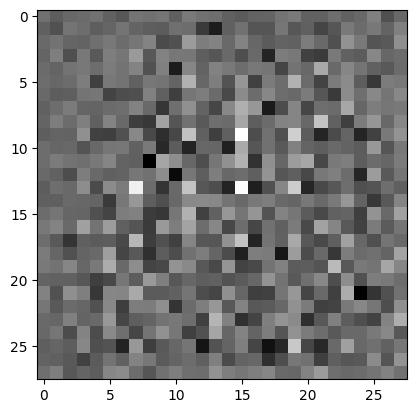

In [205]:
generator = make_generator_model()

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

In [206]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[-0.00321005]], shape=(1, 1), dtype=float32)


In [207]:
generator_optimizer = tf.keras.optimizers.Adam(1e-3)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-3)

In [208]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

####Training the New Model

In [209]:
#Define the training loop
EPOCHS = 50
noise_dim = 100
num_examples_to_generate = 16

#Reusing this seed overtime (so it's easier) to visualize progress in the animated GIF
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [210]:
@tf.function #to compile the function
def train_step(images):
  noise = tf.random.normal([BATCH_SIZE, noise_dim])
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_images = generator(noise, training=True)

    real_output = discriminator(images, training=True)
    fake_output = discriminator(generated_images, training=True)

    gen_loss = generator_loss(fake_output)
    disc_loss = discriminator_loss(real_output, fake_output)

  gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
  gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

  return gen_loss, disc_loss

In [211]:
def train(dataset, epochs):
  gen_loss_history = []
  disc_loss_history = []

  for epoch in range(epochs):
    start = time.time()

    epoch_gen_loss = 0.0
    epoch_disc_loss = 0.0
    batch_count = 0

    for image_batch in dataset:
      gen_loss_batch, disc_loss_batch = train_step(image_batch)

      epoch_gen_loss += float(gen_loss_batch.numpy())
      epoch_disc_loss += float(disc_loss_batch.numpy())
      batch_count += 1

    #average loss over batches
    epoch_gen_loss /= batch_count
    epoch_disc_loss /= batch_count

    gen_loss_history.append(epoch_gen_loss)
    disc_loss_history.append(epoch_disc_loss)

    #Produce images for the GIF
    display.clear_output(wait=True)
    generate_and_save_images(generator, epoch + 1, seed)

    #Save the model every 10 epochs
    if (epoch + 1) % 10 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  #Generate after the final epoch
  display.clear_output(wait=True)
  generate_and_save_images(generator, epochs, seed)

  return gen_loss_history, disc_loss_history


In [212]:
#Generate and save images
def generate_and_save_images(model, epoch, test_input):
  #training=False is so all layers run in inference mode (batchnorm)
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
    plt.subplot(4, 4, i+1)
    plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
    plt.axis('off')

  save_path = f"{run_dir}/image_at_epoch_{epoch:04d}.png"
  plt.savefig(save_path)
  plt.show()
  plt.close(fig)

In [213]:
#folder
RUN_LABEL = "AllLR(1e-3)"
run_dir = f"runs/{RUN_LABEL}"
os.makedirs(run_dir, exist_ok=True)

print("Saving images + GIF for this run in:", run_dir)

Saving images + GIF for this run in: runs/AllLR(1e-3)


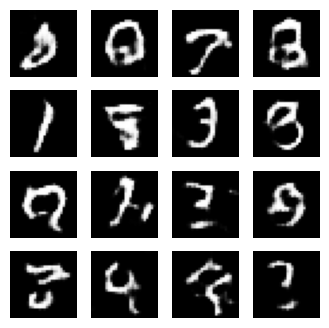

In [214]:
gen_loss_hist, disc_loss_hist = train(train_dataset, EPOCHS) #50 epochs

In [215]:
#Restore the latest checkpoint
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [216]:
#Use imageio to create an animated gif using the images saved during training
anim_file =  f"{run_dir}/dcgan.gif"

n=10

with imageio.get_writer(anim_file, mode='I', loop=n) as writer:
  filenames = glob.glob(f"{run_dir}/image_at_epoch_*.png")
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

/tmp/ipython-input-192076377.py:10: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
/tmp/ipython-input-192076377.py:12: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



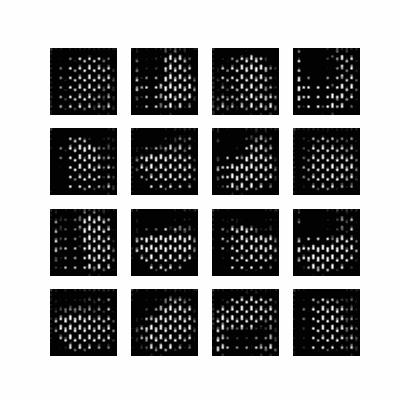

In [217]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

/tmp/ipython-input-873666131.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_start = imageio.imread(first_epoch_path)
/tmp/ipython-input-873666131.py:6: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_end = imageio.imread(final_epoch_path)


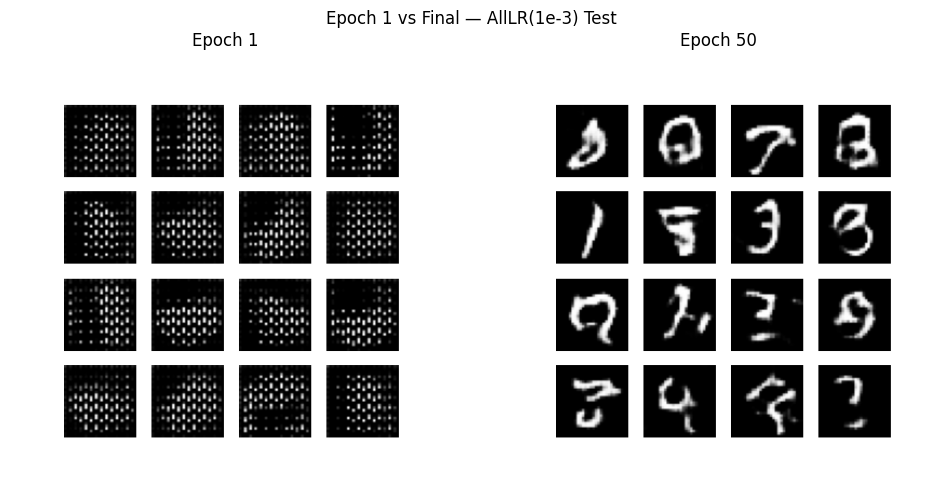

In [218]:
#Show First and Final Epoch Images
first_epoch_path = os.path.join(run_dir, "image_at_epoch_0001.png")
final_epoch_path = os.path.join(run_dir, f"image_at_epoch_{EPOCHS:04d}.png")

img_start = imageio.imread(first_epoch_path)
img_end = imageio.imread(final_epoch_path)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(img_start)
plt.title("Epoch 1")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(img_end)
plt.title(f"Epoch {EPOCHS}")
plt.axis("off")

plt.suptitle(f"Epoch 1 vs Final — {RUN_LABEL} Test")
plt.tight_layout()
plt.show()

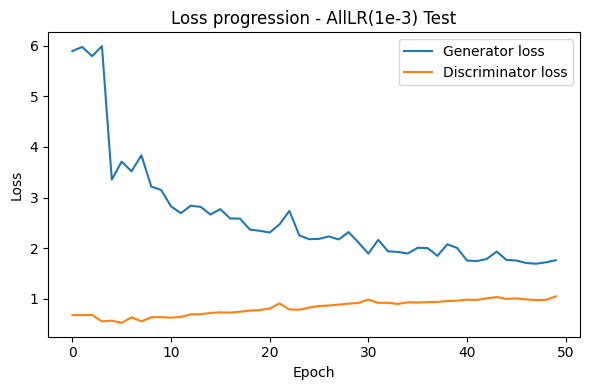

In [219]:
#Plot Loss Curves
plt.figure(figsize=(6, 4))
plt.plot(gen_loss_hist, label="Generator loss")
plt.plot(disc_loss_hist, label="Discriminator loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title(f"Loss progression - {RUN_LABEL} Test")
plt.legend()
plt.tight_layout()

loss_plot_path = f"{run_dir}/loss_curve.png"
plt.savefig(loss_plot_path)
plt.show()
plt.close()

###Test2

####Redefining Generator, Discriminator, Optimizers and Checkpoint

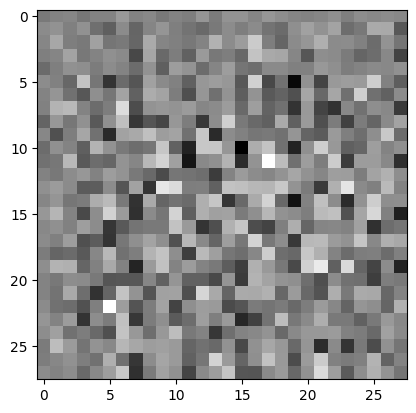

In [220]:
generator = make_generator_model()

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

In [221]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[0.00127263]], shape=(1, 1), dtype=float32)


In [222]:
generator_optimizer = tf.keras.optimizers.Adam(1e-5)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-5)

In [223]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

####Training the New Model

In [224]:
#Define the training loop
EPOCHS = 50
noise_dim = 100
num_examples_to_generate = 16

#Reusing this seed overtime (so it's easier) to visualize progress in the animated GIF
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [225]:
@tf.function #to compile the function
def train_step(images):
  noise = tf.random.normal([BATCH_SIZE, noise_dim])
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_images = generator(noise, training=True)

    real_output = discriminator(images, training=True)
    fake_output = discriminator(generated_images, training=True)

    gen_loss = generator_loss(fake_output)
    disc_loss = discriminator_loss(real_output, fake_output)

  gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
  gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

  return gen_loss, disc_loss

In [226]:
def train(dataset, epochs):
  gen_loss_history = []
  disc_loss_history = []

  for epoch in range(epochs):
    start = time.time()

    epoch_gen_loss = 0.0
    epoch_disc_loss = 0.0
    batch_count = 0

    for image_batch in dataset:
      gen_loss_batch, disc_loss_batch = train_step(image_batch)

      epoch_gen_loss += float(gen_loss_batch.numpy())
      epoch_disc_loss += float(disc_loss_batch.numpy())
      batch_count += 1

    #average loss over batches
    epoch_gen_loss /= batch_count
    epoch_disc_loss /= batch_count

    gen_loss_history.append(epoch_gen_loss)
    disc_loss_history.append(epoch_disc_loss)

    #Produce images for the GIF
    display.clear_output(wait=True)
    generate_and_save_images(generator, epoch + 1, seed)

    #Save the model every 10 epochs
    if (epoch + 1) % 10 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  #Generate after the final epoch
  display.clear_output(wait=True)
  generate_and_save_images(generator, epochs, seed)

  return gen_loss_history, disc_loss_history


In [227]:
#Generate and save images
def generate_and_save_images(model, epoch, test_input):
  #training=False is so all layers run in inference mode (batchnorm)
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
    plt.subplot(4, 4, i+1)
    plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
    plt.axis('off')

  save_path = f"{run_dir}/image_at_epoch_{epoch:04d}.png"
  plt.savefig(save_path)
  plt.show()
  plt.close(fig)

In [228]:
#folder
RUN_LABEL = "AllLR(1e-5)"
run_dir = f"runs/{RUN_LABEL}"
os.makedirs(run_dir, exist_ok=True)

print("Saving images + GIF for this run in:", run_dir)

Saving images + GIF for this run in: runs/AllLR(1e-5)


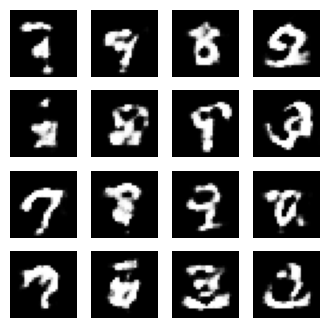

In [229]:
gen_loss_hist, disc_loss_hist = train(train_dataset, EPOCHS) #50 epochs

In [230]:
#Restore the latest checkpoint
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [231]:
#Use imageio to create an animated gif using the images saved during training
anim_file =  f"{run_dir}/dcgan.gif"

n=10

with imageio.get_writer(anim_file, mode='I', loop=n) as writer:
  filenames = glob.glob(f"{run_dir}/image_at_epoch_*.png")
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

/tmp/ipython-input-192076377.py:10: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
/tmp/ipython-input-192076377.py:12: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



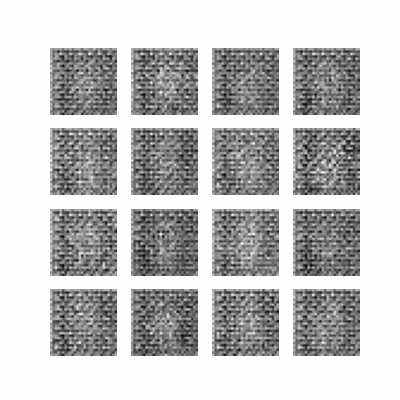

In [232]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

/tmp/ipython-input-873666131.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_start = imageio.imread(first_epoch_path)
/tmp/ipython-input-873666131.py:6: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_end = imageio.imread(final_epoch_path)


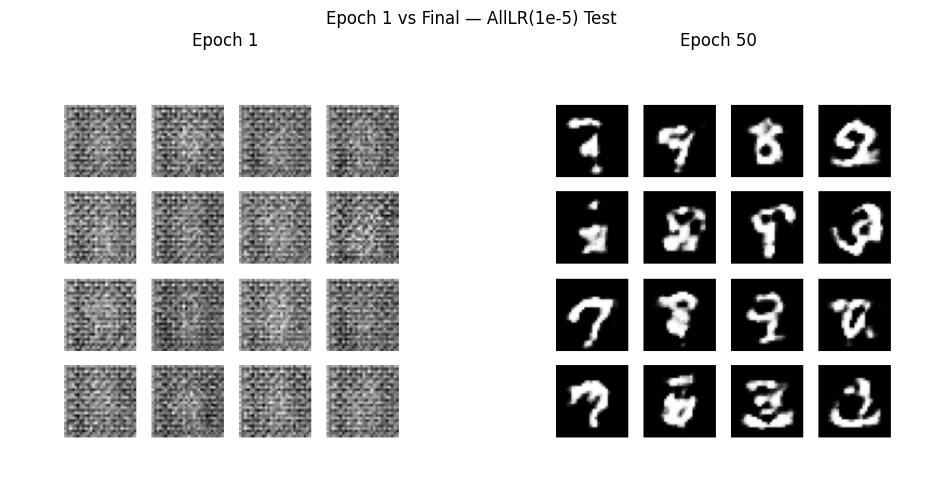

In [233]:
#Show First and Final Epoch Images
first_epoch_path = os.path.join(run_dir, "image_at_epoch_0001.png")
final_epoch_path = os.path.join(run_dir, f"image_at_epoch_{EPOCHS:04d}.png")

img_start = imageio.imread(first_epoch_path)
img_end = imageio.imread(final_epoch_path)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(img_start)
plt.title("Epoch 1")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(img_end)
plt.title(f"Epoch {EPOCHS}")
plt.axis("off")

plt.suptitle(f"Epoch 1 vs Final — {RUN_LABEL} Test")
plt.tight_layout()
plt.show()

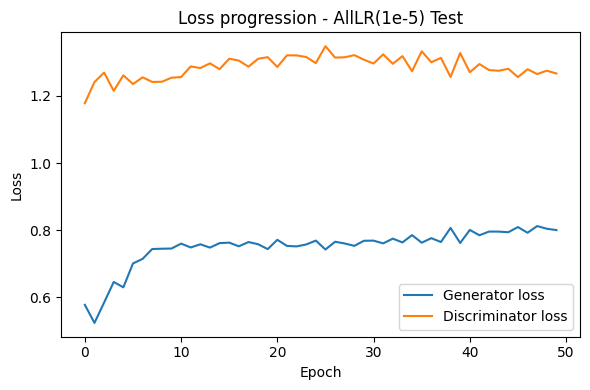

In [234]:
#Plot Loss Curves
plt.figure(figsize=(6, 4))
plt.plot(gen_loss_hist, label="Generator loss")
plt.plot(disc_loss_hist, label="Discriminator loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title(f"Loss progression - {RUN_LABEL} Test")
plt.legend()
plt.tight_layout()

loss_plot_path = f"{run_dir}/loss_curve.png"
plt.savefig(loss_plot_path)
plt.show()
plt.close()

###Test3

####Redefining Generator, Discriminator, Optimizers and Checkpoint

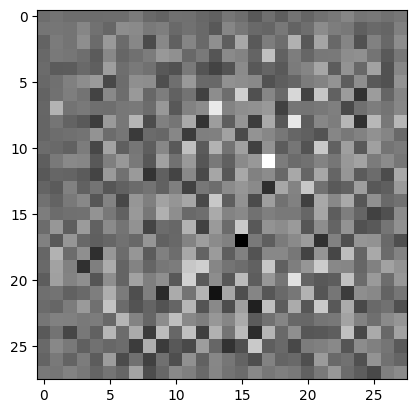

In [235]:
generator = make_generator_model()

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

In [236]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[-0.00098186]], shape=(1, 1), dtype=float32)


In [237]:
generator_optimizer = tf.keras.optimizers.Adam(1e-5)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

In [238]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

####Training the New Model

In [239]:
#Define the training loop
EPOCHS = 50
noise_dim = 100
num_examples_to_generate = 16

#Reusing this seed overtime (so it's easier) to visualize progress in the animated GIF
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [240]:
@tf.function #to compile the function
def train_step(images):
  noise = tf.random.normal([BATCH_SIZE, noise_dim])
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_images = generator(noise, training=True)

    real_output = discriminator(images, training=True)
    fake_output = discriminator(generated_images, training=True)

    gen_loss = generator_loss(fake_output)
    disc_loss = discriminator_loss(real_output, fake_output)

  gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
  gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

  return gen_loss, disc_loss

In [241]:
def train(dataset, epochs):
  gen_loss_history = []
  disc_loss_history = []

  for epoch in range(epochs):
    start = time.time()

    epoch_gen_loss = 0.0
    epoch_disc_loss = 0.0
    batch_count = 0

    for image_batch in dataset:
      gen_loss_batch, disc_loss_batch = train_step(image_batch)

      epoch_gen_loss += float(gen_loss_batch.numpy())
      epoch_disc_loss += float(disc_loss_batch.numpy())
      batch_count += 1

    #average loss over batches
    epoch_gen_loss /= batch_count
    epoch_disc_loss /= batch_count

    gen_loss_history.append(epoch_gen_loss)
    disc_loss_history.append(epoch_disc_loss)

    #Produce images for the GIF
    display.clear_output(wait=True)
    generate_and_save_images(generator, epoch + 1, seed)

    #Save the model every 10 epochs
    if (epoch + 1) % 10 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  #Generate after the final epoch
  display.clear_output(wait=True)
  generate_and_save_images(generator, epochs, seed)

  return gen_loss_history, disc_loss_history


In [242]:
#Generate and save images
def generate_and_save_images(model, epoch, test_input):
  #training=False is so all layers run in inference mode (batchnorm)
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
    plt.subplot(4, 4, i+1)
    plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
    plt.axis('off')

  save_path = f"{run_dir}/image_at_epoch_{epoch:04d}.png"
  plt.savefig(save_path)
  plt.show()
  plt.close(fig)

In [243]:
#folder
RUN_LABEL = "GenLR(1e-5)_DisLR(1e-4)"
run_dir = f"runs/{RUN_LABEL}"
os.makedirs(run_dir, exist_ok=True)

print("Saving images + GIF for this run in:", run_dir)

Saving images + GIF for this run in: runs/GenLR(1e-5)_DisLR(1e-4)


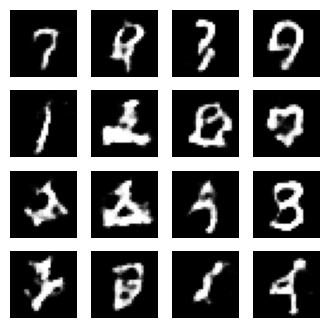

In [244]:
gen_loss_hist, disc_loss_hist = train(train_dataset, EPOCHS) #50 epochs

In [245]:
#Restore the latest checkpoint
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [246]:
#Use imageio to create an animated gif using the images saved during training
anim_file =  f"{run_dir}/dcgan.gif"

n=10

with imageio.get_writer(anim_file, mode='I', loop=n) as writer:
  filenames = glob.glob(f"{run_dir}/image_at_epoch_*.png")
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

/tmp/ipython-input-192076377.py:10: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
/tmp/ipython-input-192076377.py:12: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



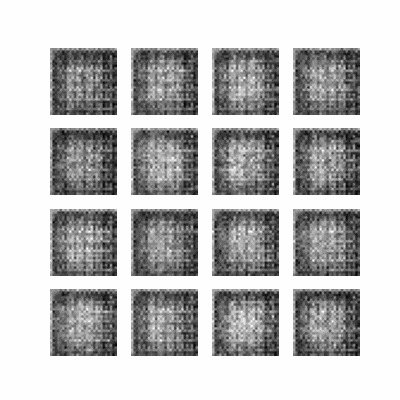

In [247]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

/tmp/ipython-input-873666131.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_start = imageio.imread(first_epoch_path)
/tmp/ipython-input-873666131.py:6: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_end = imageio.imread(final_epoch_path)


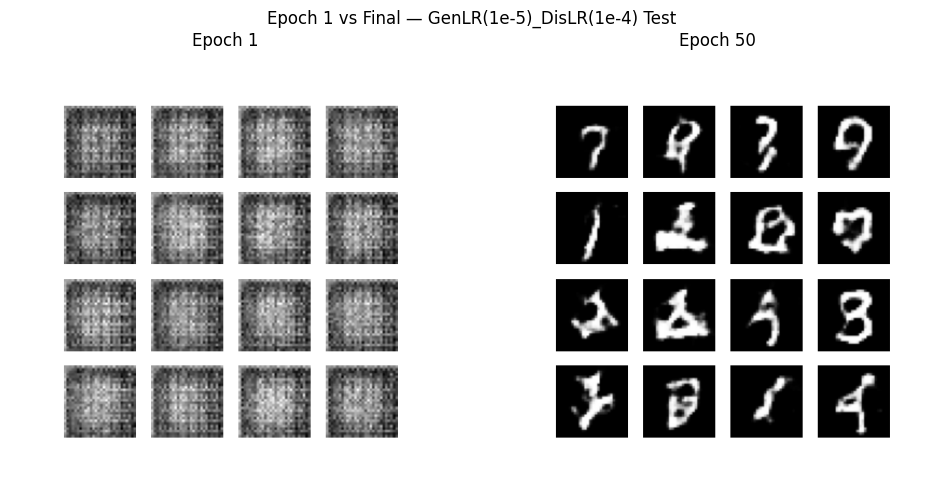

In [248]:
#Show First and Final Epoch Images
first_epoch_path = os.path.join(run_dir, "image_at_epoch_0001.png")
final_epoch_path = os.path.join(run_dir, f"image_at_epoch_{EPOCHS:04d}.png")

img_start = imageio.imread(first_epoch_path)
img_end = imageio.imread(final_epoch_path)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(img_start)
plt.title("Epoch 1")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(img_end)
plt.title(f"Epoch {EPOCHS}")
plt.axis("off")

plt.suptitle(f"Epoch 1 vs Final — {RUN_LABEL} Test")
plt.tight_layout()
plt.show()

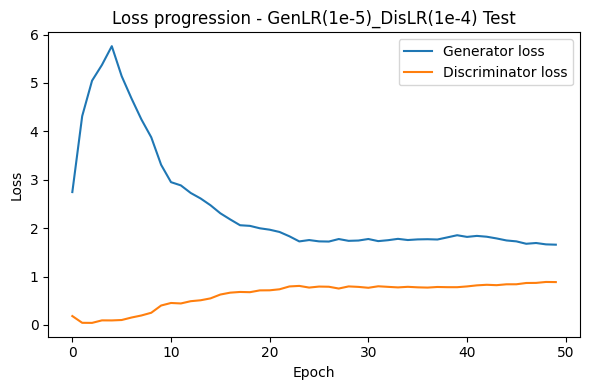

In [249]:
#Plot Loss Curves
plt.figure(figsize=(6, 4))
plt.plot(gen_loss_hist, label="Generator loss")
plt.plot(disc_loss_hist, label="Discriminator loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title(f"Loss progression - {RUN_LABEL} Test")
plt.legend()
plt.tight_layout()

loss_plot_path = f"{run_dir}/loss_curve.png"
plt.savefig(loss_plot_path)
plt.show()
plt.close()

###Test4

####Redefining Generator, Discriminator, Optimizers and Checkpoint

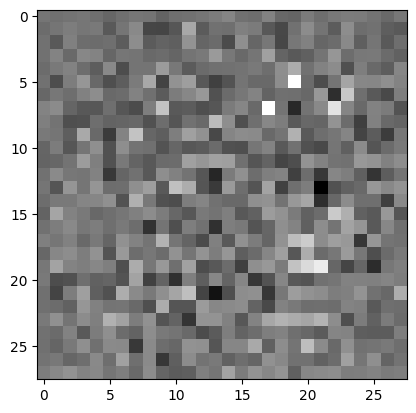

In [250]:
generator = make_generator_model()

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

In [251]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[0.00123763]], shape=(1, 1), dtype=float32)


In [252]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-5)

In [253]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

####Training the New Model

In [254]:
#Define the training loop
EPOCHS = 50
noise_dim = 100
num_examples_to_generate = 16

#Reusing this seed overtime (so it's easier) to visualize progress in the animated GIF
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [255]:
@tf.function #to compile the function
def train_step(images):
  noise = tf.random.normal([BATCH_SIZE, noise_dim])
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_images = generator(noise, training=True)

    real_output = discriminator(images, training=True)
    fake_output = discriminator(generated_images, training=True)

    gen_loss = generator_loss(fake_output)
    disc_loss = discriminator_loss(real_output, fake_output)

  gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
  gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

  return gen_loss, disc_loss

In [256]:
def train(dataset, epochs):
  gen_loss_history = []
  disc_loss_history = []

  for epoch in range(epochs):
    start = time.time()

    epoch_gen_loss = 0.0
    epoch_disc_loss = 0.0
    batch_count = 0

    for image_batch in dataset:
      gen_loss_batch, disc_loss_batch = train_step(image_batch)

      epoch_gen_loss += float(gen_loss_batch.numpy())
      epoch_disc_loss += float(disc_loss_batch.numpy())
      batch_count += 1

    #average loss over batches
    epoch_gen_loss /= batch_count
    epoch_disc_loss /= batch_count

    gen_loss_history.append(epoch_gen_loss)
    disc_loss_history.append(epoch_disc_loss)

    #Produce images for the GIF
    display.clear_output(wait=True)
    generate_and_save_images(generator, epoch + 1, seed)

    #Save the model every 10 epochs
    if (epoch + 1) % 10 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  #Generate after the final epoch
  display.clear_output(wait=True)
  generate_and_save_images(generator, epochs, seed)

  return gen_loss_history, disc_loss_history


In [257]:
#Generate and save images
def generate_and_save_images(model, epoch, test_input):
  #training=False is so all layers run in inference mode (batchnorm)
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
    plt.subplot(4, 4, i+1)
    plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
    plt.axis('off')

  save_path = f"{run_dir}/image_at_epoch_{epoch:04d}.png"
  plt.savefig(save_path)
  plt.show()
  plt.close(fig)

In [258]:
#folder
RUN_LABEL = "GenLR(1e-4)_DisLR(1e-5)"
run_dir = f"runs/{RUN_LABEL}"
os.makedirs(run_dir, exist_ok=True)

print("Saving images + GIF for this run in:", run_dir)

Saving images + GIF for this run in: runs/GenLR(1e-4)_DisLR(1e-5)


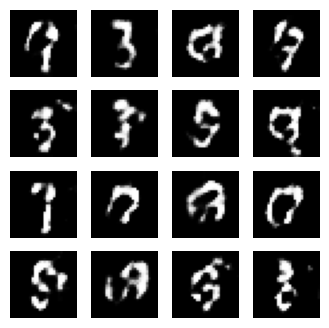

In [259]:
gen_loss_hist, disc_loss_hist = train(train_dataset, EPOCHS) #50 epochs

In [260]:
#Restore the latest checkpoint
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [261]:
#Use imageio to create an animated gif using the images saved during training
anim_file =  f"{run_dir}/dcgan.gif"

n=10

with imageio.get_writer(anim_file, mode='I', loop=n) as writer:
  filenames = glob.glob(f"{run_dir}/image_at_epoch_*.png")
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

/tmp/ipython-input-192076377.py:10: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
/tmp/ipython-input-192076377.py:12: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



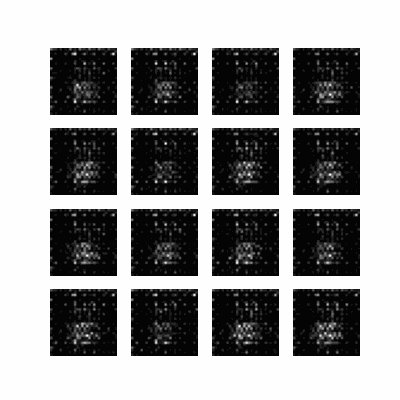

In [262]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

/tmp/ipython-input-873666131.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_start = imageio.imread(first_epoch_path)
/tmp/ipython-input-873666131.py:6: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_end = imageio.imread(final_epoch_path)


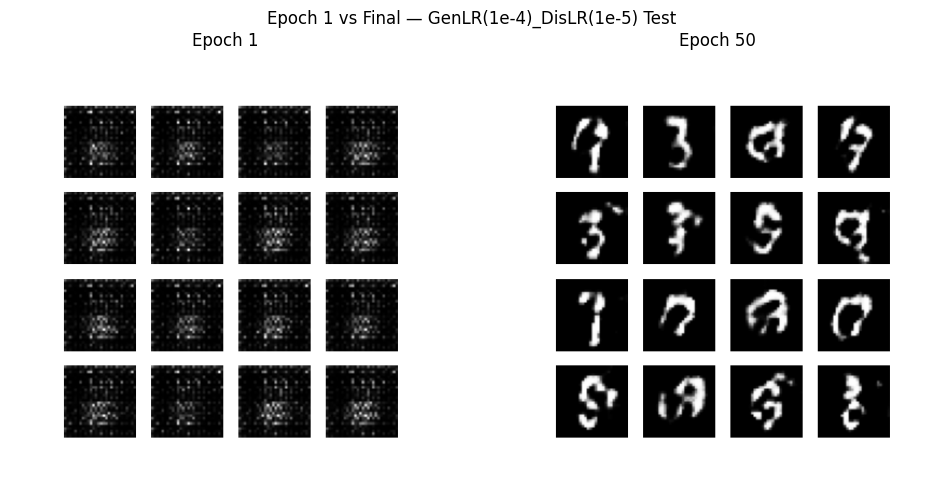

In [263]:
#Show First and Final Epoch Images
first_epoch_path = os.path.join(run_dir, "image_at_epoch_0001.png")
final_epoch_path = os.path.join(run_dir, f"image_at_epoch_{EPOCHS:04d}.png")

img_start = imageio.imread(first_epoch_path)
img_end = imageio.imread(final_epoch_path)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(img_start)
plt.title("Epoch 1")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(img_end)
plt.title(f"Epoch {EPOCHS}")
plt.axis("off")

plt.suptitle(f"Epoch 1 vs Final — {RUN_LABEL} Test")
plt.tight_layout()
plt.show()

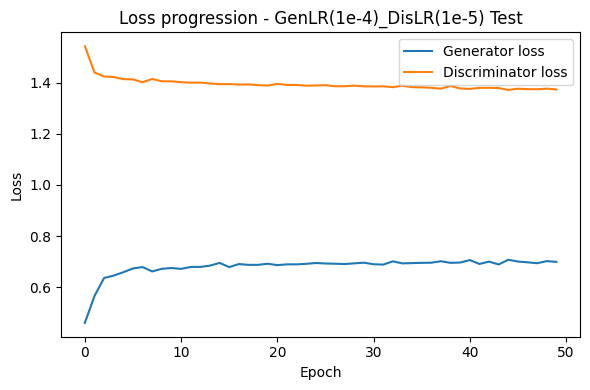

In [264]:
#Plot Loss Curves
plt.figure(figsize=(6, 4))
plt.plot(gen_loss_hist, label="Generator loss")
plt.plot(disc_loss_hist, label="Discriminator loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title(f"Loss progression - {RUN_LABEL} Test")
plt.legend()
plt.tight_layout()

loss_plot_path = f"{run_dir}/loss_curve.png"
plt.savefig(loss_plot_path)
plt.show()
plt.close()

##Momentum Terms
The chosen optimizer, Adam, keeps two internal momentum terms per weight:
- beta_1 (first moment(m)) = the exponential moving average of the gradients
- beta_2 (second moment(v)) = the exponential moving average of the *squared* gradients
---
Testing against the Baseline (beta_1 = 0.9 , beta_2 = 0.999)
* Test 1: Momentum 1 Tuning
  * Test 1.1: Beta_1 = 0.99
  * Test 1.2: Beta_1 = 0.4
* Test 2: Momentum 2 Tuning
  * Test 2.1: Beta_2 = 0.99
  * Test 2.2: Beta_2 = 0.9




###Test1.1

####Redefining Generator, Discriminator, Optimizers and Checkpoint

In [269]:
def make_generator_model():
  model = tf.keras.Sequential()
  model.add(layers.Dense(7*7*256, use_bias=False, input_shape=(100,)))
  model.add(layers.BatchNormalization())
  model.add(layers.ReLU())

  model.add(layers.Reshape((7, 7, 256)))
  assert model.output_shape == (None, 7, 7, 256) # Note: None is the batch size

  model.add(layers.Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same', use_bias=False))
  assert model.output_shape == (None, 7, 7, 128)
  model.add(layers.BatchNormalization())
  model.add(layers.ReLU())

  model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
  assert model.output_shape == (None, 14, 14, 64)
  model.add(layers.BatchNormalization())
  model.add(layers.ReLU())

  model.add(layers.Conv2DTranspose(1, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
  assert model.output_shape == (None, 28, 28, 1)

  return model

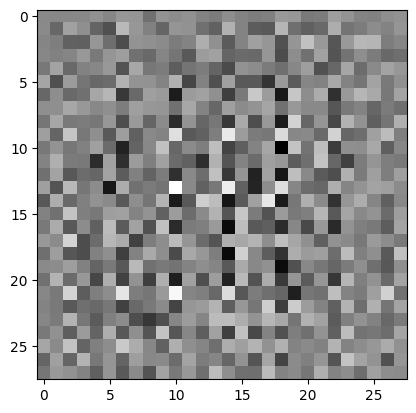

In [270]:
generator = make_generator_model()

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

In [271]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[0.00019649]], shape=(1, 1), dtype=float32)


In [272]:
generator_optimizer = tf.keras.optimizers.Adam(
    learning_rate=1e-4,
    beta_1=0.99,
    beta_2=0.999
)
discriminator_optimizer = tf.keras.optimizers.Adam(
    learning_rate=1e-4,
    beta_1=0.99,
    beta_2=0.999
)

In [273]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

####Training the New Model

In [274]:
#Define the training loop
EPOCHS = 50
noise_dim = 100
num_examples_to_generate = 16

#Reusing this seed overtime (so it's easier) to visualize progress in the animated GIF
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [275]:
@tf.function #to compile the function
def train_step(images):
  noise = tf.random.normal([BATCH_SIZE, noise_dim])
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_images = generator(noise, training=True)

    real_output = discriminator(images, training=True)
    fake_output = discriminator(generated_images, training=True)

    gen_loss = generator_loss(fake_output)
    disc_loss = discriminator_loss(real_output, fake_output)

  gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
  gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

  return gen_loss, disc_loss

In [276]:
def train(dataset, epochs):
  gen_loss_history = []
  disc_loss_history = []

  for epoch in range(epochs):
    start = time.time()

    epoch_gen_loss = 0.0
    epoch_disc_loss = 0.0
    batch_count = 0

    for image_batch in dataset:
      gen_loss_batch, disc_loss_batch = train_step(image_batch)

      epoch_gen_loss += float(gen_loss_batch.numpy())
      epoch_disc_loss += float(disc_loss_batch.numpy())
      batch_count += 1

    #average loss over batches
    epoch_gen_loss /= batch_count
    epoch_disc_loss /= batch_count

    gen_loss_history.append(epoch_gen_loss)
    disc_loss_history.append(epoch_disc_loss)

    #Produce images for the GIF
    display.clear_output(wait=True)
    generate_and_save_images(generator, epoch + 1, seed)

    #Save the model every 10 epochs
    if (epoch + 1) % 10 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  #Generate after the final epoch
  display.clear_output(wait=True)
  generate_and_save_images(generator, epochs, seed)

  return gen_loss_history, disc_loss_history


In [277]:
#Generate and save images
def generate_and_save_images(model, epoch, test_input):
  #training=False is so all layers run in inference mode (batchnorm)
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
    plt.subplot(4, 4, i+1)
    plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
    plt.axis('off')

  save_path = f"{run_dir}/image_at_epoch_{epoch:04d}.png"
  plt.savefig(save_path)
  plt.show()
  plt.close(fig)

In [278]:
#folder
RUN_LABEL = "Beta_1(0.99)"
run_dir = f"runs/{RUN_LABEL}"
os.makedirs(run_dir, exist_ok=True)

print("Saving images + GIF for this run in:", run_dir)

Saving images + GIF for this run in: runs/Beta_1(0.99)


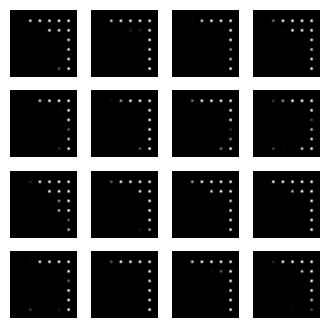

In [279]:
gen_loss_hist, disc_loss_hist = train(train_dataset, EPOCHS) #50 epochs

In [280]:
#Restore the latest checkpoint
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [281]:
#Use imageio to create an animated gif using the images saved during training
anim_file =  f"{run_dir}/dcgan.gif"

n=10

with imageio.get_writer(anim_file, mode='I', loop=n) as writer:
  filenames = glob.glob(f"{run_dir}/image_at_epoch_*.png")
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

/tmp/ipython-input-192076377.py:10: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
/tmp/ipython-input-192076377.py:12: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



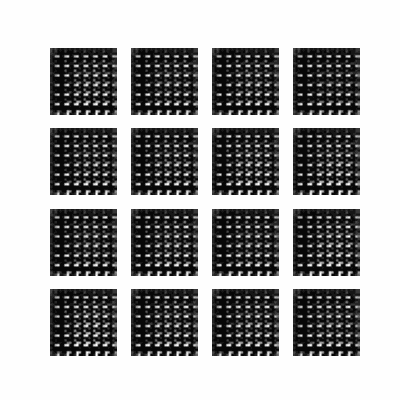

In [282]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

/tmp/ipython-input-873666131.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_start = imageio.imread(first_epoch_path)
/tmp/ipython-input-873666131.py:6: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_end = imageio.imread(final_epoch_path)


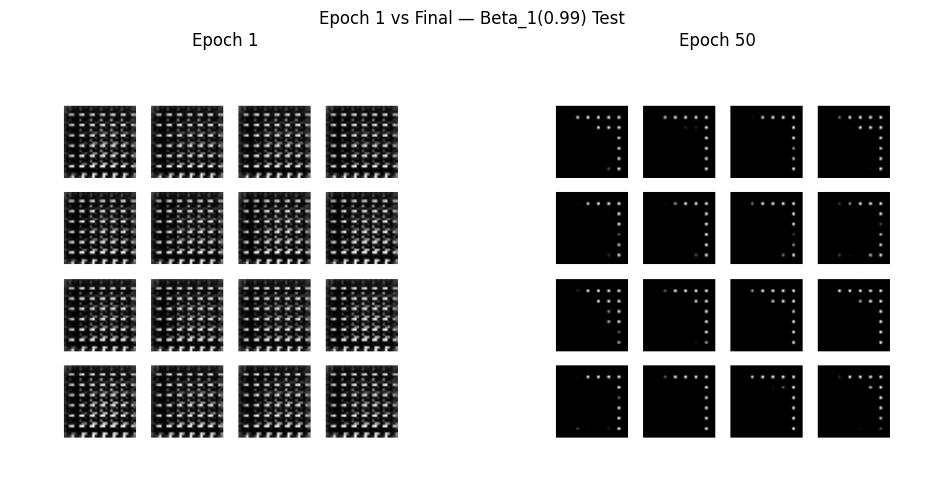

In [283]:
#Show First and Final Epoch Images
first_epoch_path = os.path.join(run_dir, "image_at_epoch_0001.png")
final_epoch_path = os.path.join(run_dir, f"image_at_epoch_{EPOCHS:04d}.png")

img_start = imageio.imread(first_epoch_path)
img_end = imageio.imread(final_epoch_path)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(img_start)
plt.title("Epoch 1")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(img_end)
plt.title(f"Epoch {EPOCHS}")
plt.axis("off")

plt.suptitle(f"Epoch 1 vs Final — {RUN_LABEL} Test")
plt.tight_layout()
plt.show()

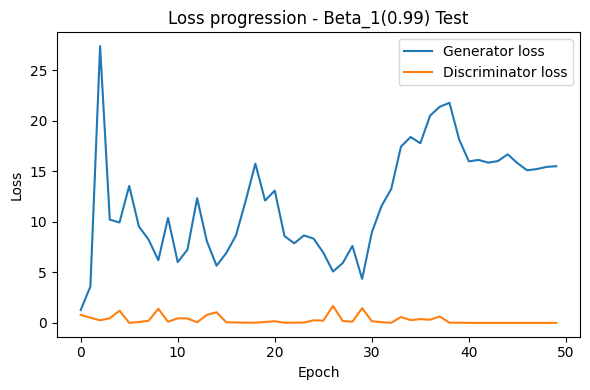

In [284]:
#Plot Loss Curves
plt.figure(figsize=(6, 4))
plt.plot(gen_loss_hist, label="Generator loss")
plt.plot(disc_loss_hist, label="Discriminator loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title(f"Loss progression - {RUN_LABEL} Test")
plt.legend()
plt.tight_layout()

loss_plot_path = f"{run_dir}/loss_curve.png"
plt.savefig(loss_plot_path)
plt.show()
plt.close()

###Test1.2

####Redefining Generator, Discriminator, Optimizers and Checkpoint

In [285]:
def make_generator_model():
  model = tf.keras.Sequential()
  model.add(layers.Dense(7*7*256, use_bias=False, input_shape=(100,)))
  model.add(layers.BatchNormalization())
  model.add(layers.ReLU())

  model.add(layers.Reshape((7, 7, 256)))
  assert model.output_shape == (None, 7, 7, 256) # Note: None is the batch size

  model.add(layers.Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same', use_bias=False))
  assert model.output_shape == (None, 7, 7, 128)
  model.add(layers.BatchNormalization())
  model.add(layers.ReLU())

  model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
  assert model.output_shape == (None, 14, 14, 64)
  model.add(layers.BatchNormalization())
  model.add(layers.ReLU())

  model.add(layers.Conv2DTranspose(1, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
  assert model.output_shape == (None, 28, 28, 1)

  return model

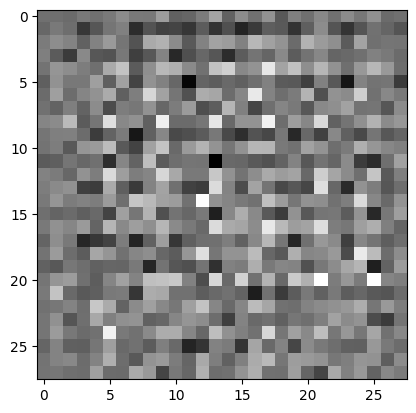

In [286]:
generator = make_generator_model()

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

In [287]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[0.00184731]], shape=(1, 1), dtype=float32)


In [288]:
generator_optimizer = tf.keras.optimizers.Adam(
    learning_rate=1e-4,
    beta_1=0.4,
    beta_2=0.999
)
discriminator_optimizer = tf.keras.optimizers.Adam(
    learning_rate=1e-4,
    beta_1=0.4,
    beta_2=0.999
)

In [289]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

####Training the New Model

In [290]:
#Define the training loop
EPOCHS = 50
noise_dim = 100
num_examples_to_generate = 16

#Reusing this seed overtime (so it's easier) to visualize progress in the animated GIF
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [291]:
@tf.function #to compile the function
def train_step(images):
  noise = tf.random.normal([BATCH_SIZE, noise_dim])
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_images = generator(noise, training=True)

    real_output = discriminator(images, training=True)
    fake_output = discriminator(generated_images, training=True)

    gen_loss = generator_loss(fake_output)
    disc_loss = discriminator_loss(real_output, fake_output)

  gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
  gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

  return gen_loss, disc_loss

In [292]:
def train(dataset, epochs):
  gen_loss_history = []
  disc_loss_history = []

  for epoch in range(epochs):
    start = time.time()

    epoch_gen_loss = 0.0
    epoch_disc_loss = 0.0
    batch_count = 0

    for image_batch in dataset:
      gen_loss_batch, disc_loss_batch = train_step(image_batch)

      epoch_gen_loss += float(gen_loss_batch.numpy())
      epoch_disc_loss += float(disc_loss_batch.numpy())
      batch_count += 1

    #average loss over batches
    epoch_gen_loss /= batch_count
    epoch_disc_loss /= batch_count

    gen_loss_history.append(epoch_gen_loss)
    disc_loss_history.append(epoch_disc_loss)

    #Produce images for the GIF
    display.clear_output(wait=True)
    generate_and_save_images(generator, epoch + 1, seed)

    #Save the model every 10 epochs
    if (epoch + 1) % 10 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  #Generate after the final epoch
  display.clear_output(wait=True)
  generate_and_save_images(generator, epochs, seed)

  return gen_loss_history, disc_loss_history


In [293]:
#Generate and save images
def generate_and_save_images(model, epoch, test_input):
  #training=False is so all layers run in inference mode (batchnorm)
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
    plt.subplot(4, 4, i+1)
    plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
    plt.axis('off')

  save_path = f"{run_dir}/image_at_epoch_{epoch:04d}.png"
  plt.savefig(save_path)
  plt.show()
  plt.close(fig)

In [294]:
#folder
RUN_LABEL = "Beta_1(0.4)"
run_dir = f"runs/{RUN_LABEL}"
os.makedirs(run_dir, exist_ok=True)

print("Saving images + GIF for this run in:", run_dir)

Saving images + GIF for this run in: runs/Beta_1(0.4)


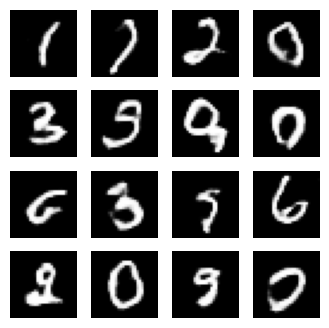

In [295]:
gen_loss_hist, disc_loss_hist = train(train_dataset, EPOCHS) #50 epochs

In [296]:
#Restore the latest checkpoint
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [297]:
#Use imageio to create an animated gif using the images saved during training
anim_file =  f"{run_dir}/dcgan.gif"

n=10

with imageio.get_writer(anim_file, mode='I', loop=n) as writer:
  filenames = glob.glob(f"{run_dir}/image_at_epoch_*.png")
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

/tmp/ipython-input-192076377.py:10: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
/tmp/ipython-input-192076377.py:12: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



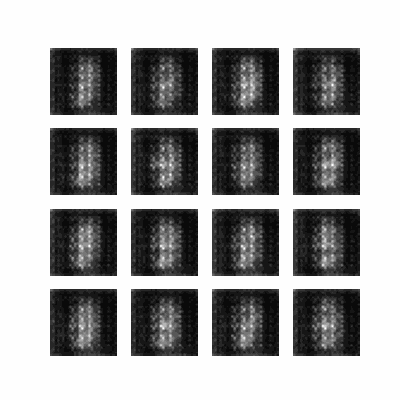

In [298]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

/tmp/ipython-input-873666131.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_start = imageio.imread(first_epoch_path)
/tmp/ipython-input-873666131.py:6: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_end = imageio.imread(final_epoch_path)


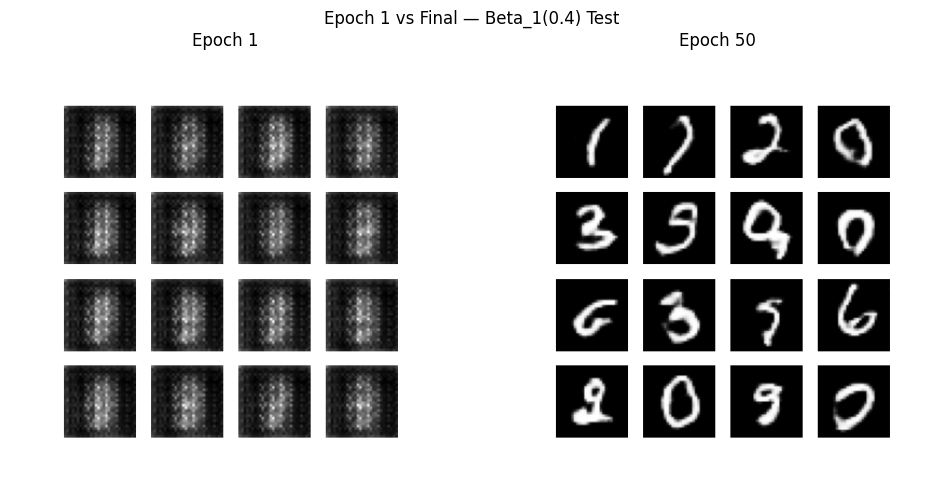

In [299]:
#Show First and Final Epoch Images
first_epoch_path = os.path.join(run_dir, "image_at_epoch_0001.png")
final_epoch_path = os.path.join(run_dir, f"image_at_epoch_{EPOCHS:04d}.png")

img_start = imageio.imread(first_epoch_path)
img_end = imageio.imread(final_epoch_path)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(img_start)
plt.title("Epoch 1")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(img_end)
plt.title(f"Epoch {EPOCHS}")
plt.axis("off")

plt.suptitle(f"Epoch 1 vs Final — {RUN_LABEL} Test")
plt.tight_layout()
plt.show()

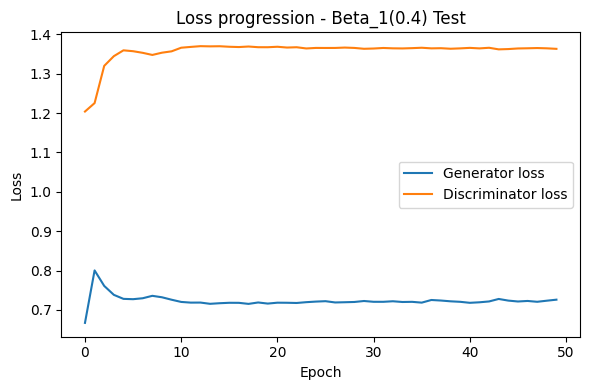

In [300]:
#Plot Loss Curves
plt.figure(figsize=(6, 4))
plt.plot(gen_loss_hist, label="Generator loss")
plt.plot(disc_loss_hist, label="Discriminator loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title(f"Loss progression - {RUN_LABEL} Test")
plt.legend()
plt.tight_layout()

loss_plot_path = f"{run_dir}/loss_curve.png"
plt.savefig(loss_plot_path)
plt.show()
plt.close()

###Test2.1

####Redefining Generator, Discriminator, Optimizers and Checkpoint

In [301]:
def make_generator_model():
  model = tf.keras.Sequential()
  model.add(layers.Dense(7*7*256, use_bias=False, input_shape=(100,)))
  model.add(layers.BatchNormalization())
  model.add(layers.ReLU())

  model.add(layers.Reshape((7, 7, 256)))
  assert model.output_shape == (None, 7, 7, 256) # Note: None is the batch size

  model.add(layers.Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same', use_bias=False))
  assert model.output_shape == (None, 7, 7, 128)
  model.add(layers.BatchNormalization())
  model.add(layers.ReLU())

  model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
  assert model.output_shape == (None, 14, 14, 64)
  model.add(layers.BatchNormalization())
  model.add(layers.ReLU())

  model.add(layers.Conv2DTranspose(1, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
  assert model.output_shape == (None, 28, 28, 1)

  return model

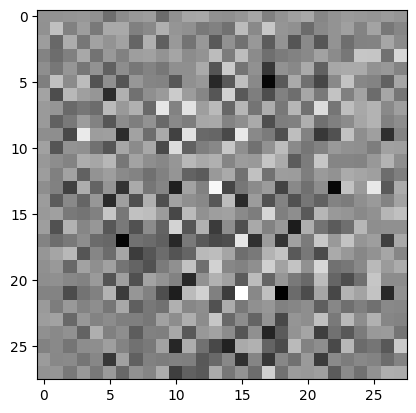

In [302]:
generator = make_generator_model()

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

In [303]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[-7.954892e-05]], shape=(1, 1), dtype=float32)


In [304]:
generator_optimizer = tf.keras.optimizers.Adam(
    learning_rate=1e-4,
    beta_1=0.99,
    beta_2=0.99
)
discriminator_optimizer = tf.keras.optimizers.Adam(
    learning_rate=1e-4,
    beta_1=0.99,
    beta_2=0.99
)

In [305]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

####Training the New Model

In [306]:
#Define the training loop
EPOCHS = 50
noise_dim = 100
num_examples_to_generate = 16

#Reusing this seed overtime (so it's easier) to visualize progress in the animated GIF
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [307]:
@tf.function #to compile the function
def train_step(images):
  noise = tf.random.normal([BATCH_SIZE, noise_dim])
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_images = generator(noise, training=True)

    real_output = discriminator(images, training=True)
    fake_output = discriminator(generated_images, training=True)

    gen_loss = generator_loss(fake_output)
    disc_loss = discriminator_loss(real_output, fake_output)

  gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
  gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

  return gen_loss, disc_loss

In [308]:
def train(dataset, epochs):
  gen_loss_history = []
  disc_loss_history = []

  for epoch in range(epochs):
    start = time.time()

    epoch_gen_loss = 0.0
    epoch_disc_loss = 0.0
    batch_count = 0

    for image_batch in dataset:
      gen_loss_batch, disc_loss_batch = train_step(image_batch)

      epoch_gen_loss += float(gen_loss_batch.numpy())
      epoch_disc_loss += float(disc_loss_batch.numpy())
      batch_count += 1

    #average loss over batches
    epoch_gen_loss /= batch_count
    epoch_disc_loss /= batch_count

    gen_loss_history.append(epoch_gen_loss)
    disc_loss_history.append(epoch_disc_loss)

    #Produce images for the GIF
    display.clear_output(wait=True)
    generate_and_save_images(generator, epoch + 1, seed)

    #Save the model every 10 epochs
    if (epoch + 1) % 10 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  #Generate after the final epoch
  display.clear_output(wait=True)
  generate_and_save_images(generator, epochs, seed)

  return gen_loss_history, disc_loss_history


In [309]:
#Generate and save images
def generate_and_save_images(model, epoch, test_input):
  #training=False is so all layers run in inference mode (batchnorm)
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
    plt.subplot(4, 4, i+1)
    plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
    plt.axis('off')

  save_path = f"{run_dir}/image_at_epoch_{epoch:04d}.png"
  plt.savefig(save_path)
  plt.show()
  plt.close(fig)

In [310]:
#folder
RUN_LABEL = "Beta_2(0.99)"
run_dir = f"runs/{RUN_LABEL}"
os.makedirs(run_dir, exist_ok=True)

print("Saving images + GIF for this run in:", run_dir)

Saving images + GIF for this run in: runs/Beta_2(0.99)


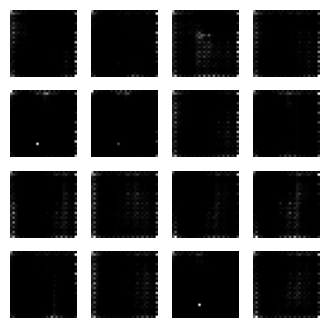

In [311]:
gen_loss_hist, disc_loss_hist = train(train_dataset, EPOCHS) #50 epochs

In [312]:
#Restore the latest checkpoint
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [313]:
#Use imageio to create an animated gif using the images saved during training
anim_file =  f"{run_dir}/dcgan.gif"

n=10

with imageio.get_writer(anim_file, mode='I', loop=n) as writer:
  filenames = glob.glob(f"{run_dir}/image_at_epoch_*.png")
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

/tmp/ipython-input-192076377.py:10: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
/tmp/ipython-input-192076377.py:12: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



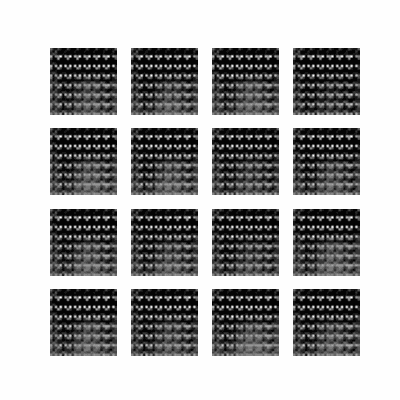

In [314]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

/tmp/ipython-input-873666131.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_start = imageio.imread(first_epoch_path)
/tmp/ipython-input-873666131.py:6: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_end = imageio.imread(final_epoch_path)


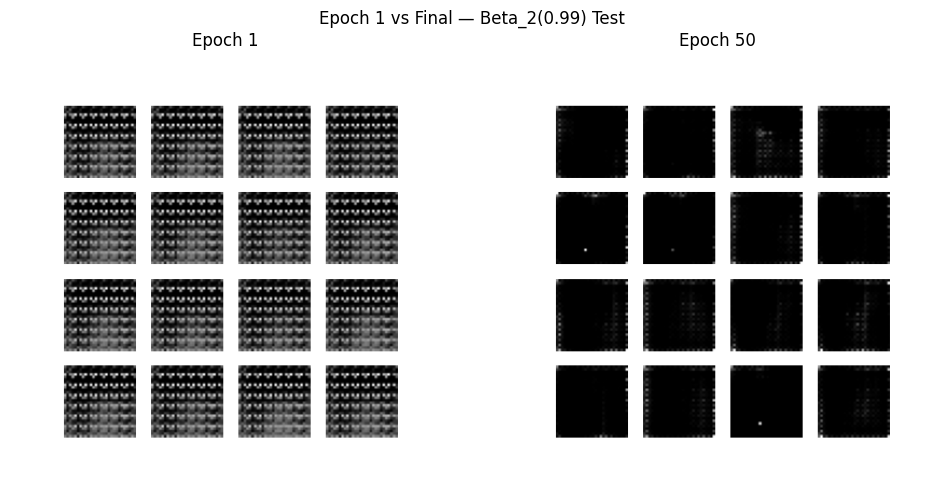

In [315]:
#Show First and Final Epoch Images
first_epoch_path = os.path.join(run_dir, "image_at_epoch_0001.png")
final_epoch_path = os.path.join(run_dir, f"image_at_epoch_{EPOCHS:04d}.png")

img_start = imageio.imread(first_epoch_path)
img_end = imageio.imread(final_epoch_path)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(img_start)
plt.title("Epoch 1")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(img_end)
plt.title(f"Epoch {EPOCHS}")
plt.axis("off")

plt.suptitle(f"Epoch 1 vs Final — {RUN_LABEL} Test")
plt.tight_layout()
plt.show()

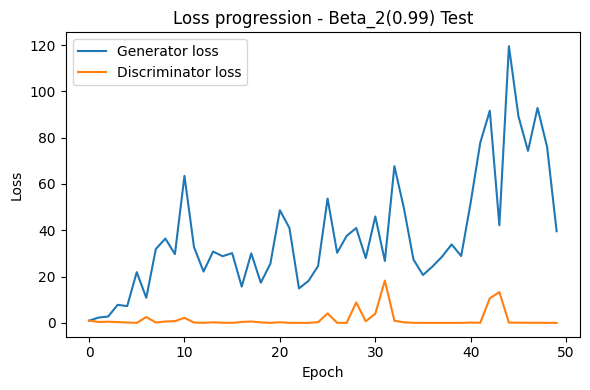

In [316]:
#Plot Loss Curves
plt.figure(figsize=(6, 4))
plt.plot(gen_loss_hist, label="Generator loss")
plt.plot(disc_loss_hist, label="Discriminator loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title(f"Loss progression - {RUN_LABEL} Test")
plt.legend()
plt.tight_layout()

loss_plot_path = f"{run_dir}/loss_curve.png"
plt.savefig(loss_plot_path)
plt.show()
plt.close()

###Test2.2

####Redefining Generator, Discriminator, Optimizers and Checkpoint

In [317]:
def make_generator_model():
  model = tf.keras.Sequential()
  model.add(layers.Dense(7*7*256, use_bias=False, input_shape=(100,)))
  model.add(layers.BatchNormalization())
  model.add(layers.ReLU())

  model.add(layers.Reshape((7, 7, 256)))
  assert model.output_shape == (None, 7, 7, 256) # Note: None is the batch size

  model.add(layers.Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same', use_bias=False))
  assert model.output_shape == (None, 7, 7, 128)
  model.add(layers.BatchNormalization())
  model.add(layers.ReLU())

  model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
  assert model.output_shape == (None, 14, 14, 64)
  model.add(layers.BatchNormalization())
  model.add(layers.ReLU())

  model.add(layers.Conv2DTranspose(1, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
  assert model.output_shape == (None, 28, 28, 1)

  return model

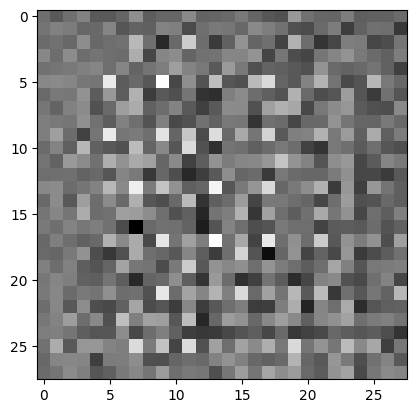

In [318]:
generator = make_generator_model()

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

In [319]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[-0.00191711]], shape=(1, 1), dtype=float32)


In [320]:
generator_optimizer = tf.keras.optimizers.Adam(
    learning_rate=1e-4,
    beta_1=0.99,
    beta_2=0.9
)
discriminator_optimizer = tf.keras.optimizers.Adam(
    learning_rate=1e-4,
    beta_1=0.99,
    beta_2=0.9
)

In [321]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

####Training the New Model

In [322]:
#Define the training loop
EPOCHS = 50
noise_dim = 100
num_examples_to_generate = 16

#Reusing this seed overtime (so it's easier) to visualize progress in the animated GIF
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [323]:
@tf.function #to compile the function
def train_step(images):
  noise = tf.random.normal([BATCH_SIZE, noise_dim])
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    generated_images = generator(noise, training=True)

    real_output = discriminator(images, training=True)
    fake_output = discriminator(generated_images, training=True)

    gen_loss = generator_loss(fake_output)
    disc_loss = discriminator_loss(real_output, fake_output)

  gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
  gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

  return gen_loss, disc_loss

In [324]:
def train(dataset, epochs):
  gen_loss_history = []
  disc_loss_history = []

  for epoch in range(epochs):
    start = time.time()

    epoch_gen_loss = 0.0
    epoch_disc_loss = 0.0
    batch_count = 0

    for image_batch in dataset:
      gen_loss_batch, disc_loss_batch = train_step(image_batch)

      epoch_gen_loss += float(gen_loss_batch.numpy())
      epoch_disc_loss += float(disc_loss_batch.numpy())
      batch_count += 1

    #average loss over batches
    epoch_gen_loss /= batch_count
    epoch_disc_loss /= batch_count

    gen_loss_history.append(epoch_gen_loss)
    disc_loss_history.append(epoch_disc_loss)

    #Produce images for the GIF
    display.clear_output(wait=True)
    generate_and_save_images(generator, epoch + 1, seed)

    #Save the model every 10 epochs
    if (epoch + 1) % 10 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  #Generate after the final epoch
  display.clear_output(wait=True)
  generate_and_save_images(generator, epochs, seed)

  return gen_loss_history, disc_loss_history


In [325]:
#Generate and save images
def generate_and_save_images(model, epoch, test_input):
  #training=False is so all layers run in inference mode (batchnorm)
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
    plt.subplot(4, 4, i+1)
    plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
    plt.axis('off')

  save_path = f"{run_dir}/image_at_epoch_{epoch:04d}.png"
  plt.savefig(save_path)
  plt.show()
  plt.close(fig)

In [326]:
#folder
RUN_LABEL = "Beta_2(0.9)"
run_dir = f"runs/{RUN_LABEL}"
os.makedirs(run_dir, exist_ok=True)

print("Saving images + GIF for this run in:", run_dir)

Saving images + GIF for this run in: runs/Beta_2(0.9)


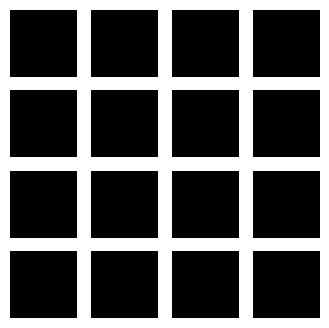

In [327]:
gen_loss_hist, disc_loss_hist = train(train_dataset, EPOCHS) #50 epochs

In [328]:
#Restore the latest checkpoint
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [329]:
#Use imageio to create an animated gif using the images saved during training
anim_file =  f"{run_dir}/dcgan.gif"

n=10

with imageio.get_writer(anim_file, mode='I', loop=n) as writer:
  filenames = glob.glob(f"{run_dir}/image_at_epoch_*.png")
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

/tmp/ipython-input-192076377.py:10: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
/tmp/ipython-input-192076377.py:12: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



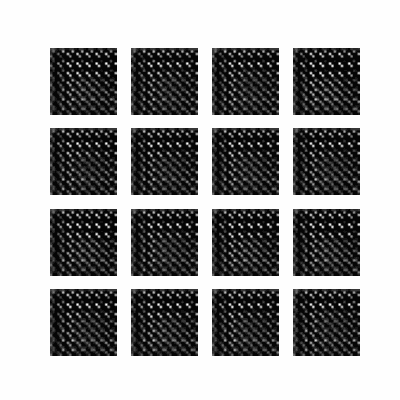

In [330]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

/tmp/ipython-input-873666131.py:5: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_start = imageio.imread(first_epoch_path)
/tmp/ipython-input-873666131.py:6: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img_end = imageio.imread(final_epoch_path)


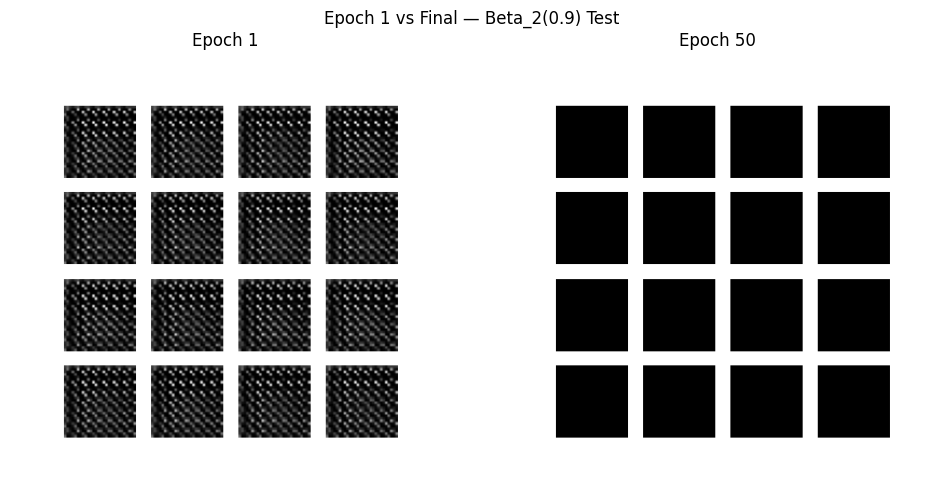

In [331]:
#Show First and Final Epoch Images
first_epoch_path = os.path.join(run_dir, "image_at_epoch_0001.png")
final_epoch_path = os.path.join(run_dir, f"image_at_epoch_{EPOCHS:04d}.png")

img_start = imageio.imread(first_epoch_path)
img_end = imageio.imread(final_epoch_path)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(img_start)
plt.title("Epoch 1")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(img_end)
plt.title(f"Epoch {EPOCHS}")
plt.axis("off")

plt.suptitle(f"Epoch 1 vs Final — {RUN_LABEL} Test")
plt.tight_layout()
plt.show()

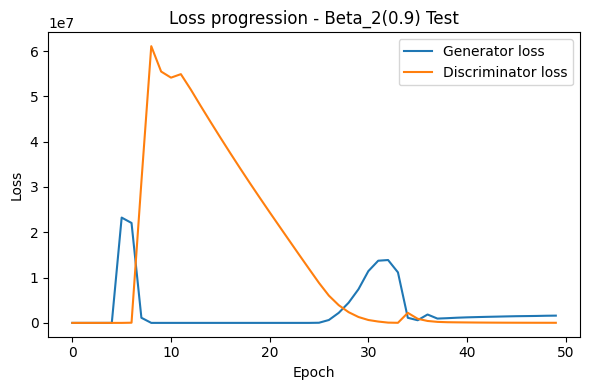

In [332]:
#Plot Loss Curves
plt.figure(figsize=(6, 4))
plt.plot(gen_loss_hist, label="Generator loss")
plt.plot(disc_loss_hist, label="Discriminator loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title(f"Loss progression - {RUN_LABEL} Test")
plt.legend()
plt.tight_layout()

loss_plot_path = f"{run_dir}/loss_curve.png"
plt.savefig(loss_plot_path)
plt.show()
plt.close()

#Final Check